In [69]:
import numpy as np
import matplotlib.pyplot as plt
# from pycqed.analysis_v2.base_analysis import BaseDataAnalysis
from pycqed.analysis import analysis_toolbox as a_tools
from pycqed.analysis_v2 import readout_analysis as ra
from pycqed.analysis import measurement_analysis as ma
import os
import matplotlib
import matplotlib.colors as mc
import datetime
import itertools
import lmfit

from importlib import reload
import h5py
from IPython.display import clear_output
# matplotlib.rcParams.update({'font.size': 20})
a_tools.datadir = "Q://USERS//nathan//data/thesis_data"
figsave_base = "C:\\Users\\nathan\\projects\\master_thesis\\appendices\\qutrit_readout\\figs\\"
clear_output()

In [2]:
fig_size_dim    = 8
golden_ratio    = (1+np.sqrt(5))/2
fig_size        = (fig_size_dim, fig_size_dim/golden_ratio)

def plot_style():
    font_size       = 16
    marker_size     = 6
    line_width      = 2.5
    axes_line_width = 1
    tick_length     = 5
    tick_width      = 1
    tick_color      = 'k'
    ticks_direction = 'in'
    axes_labelcolor = 'k'
    dpi             =  300

    params = {'figure.figsize': fig_size,
              'figure.dpi': dpi,
              'savefig.dpi': dpi,
              'font.size': font_size,
              'font.family': "DIN Pro",#"cmss10", #"DINPro", # to manage to use dinpro, put ttf files in site-packages/matplotlib/mpl-data/fonts
              'mathtext.default': 'it',
              'mathtext.fontset': "cm",
              'mathtext.it': 'cm',
              'figure.titlesize': font_size,
              'legend.fontsize': font_size,
              'axes.labelsize': font_size,
              'axes.labelcolor': axes_labelcolor,
              'axes.titlesize': font_size,
              'axes.linewidth': axes_line_width,
              'lines.markersize': marker_size,
              'lines.linewidth': line_width,
              'xtick.direction': ticks_direction,
              'ytick.direction': ticks_direction,
              'xtick.labelsize': font_size,
              'ytick.labelsize': font_size,
              'xtick.color': tick_color,
              'ytick.color': tick_color,
              'xtick.major.size': tick_length,
              'ytick.major.size': tick_length,
              'xtick.major.width': tick_width,
              'ytick.major.width': tick_width,
              'xtick.minor.size': tick_length - 2,
              'ytick.minor.size': tick_length - 2,
              'xtick.minor.width': tick_width,
              'ytick.minor.width': tick_width,
              'xtick.top': True,
              'xtick.bottom': True,
              'ytick.left': True,
              'ytick.right': True,
              'axes.formatter.useoffset': False,

              # LEGEND
            'legend.loc'           : 'best',
            'legend.frameon'       : False,     ## if True, draw the legend on a background patch
    #         'legend.framealpha'    : 0.8,      ## legend patch transparency
    #         'legend.facecolor'     : 'inherit',  ## inherit from axes.facecolor; or color spec
    #         'legend.edgecolor'     : 0.8,      ## background patch boundary color
    #         'legend.fancybox'      : True,     ## if True, use a rounded box for the
                                             ## legend background, else a rectangle
                }

    plt.rcParams.update(params)
plot_style()


## Fake init

In [3]:
from pycqed.measurement import calibration_points as c_p
from pycqed.measurement.waveform_control import pulsar as ps
from pycqed.measurement.waveform_control import segment as sg
import time
t0 = time.time()  # to print how long init takes
import logging
from pprint import pprint

import collections
odict = collections.OrderedDict

import os; os.environ['PYGSTI_BACKCOMPAT_WARNING'] = '0'
import qutip as qtp

# Qcodes
import sys
import qcodes as qc

# makes sure logging messages show up in the notebook
log = logging.getLogger()
log.addHandler(logging.StreamHandler())

# Import a_tools first so that the datadir is correct in other modules that
# import it.
from pycqed.analysis import analysis_toolbox as a_tools


# General PycQED modules
from pycqed.utilities import general as gen
from pycqed.measurement import measurement_control as mc
from pycqed.measurement import detector_functions as det
from pycqed.measurement import sweep_functions as swf
from pycqed.measurement.waveform_control import pulsar as ps
from pycqed.measurement import awg_sweep_functions as awg_swf
from pycqed.measurement import awg_sweep_functions_multi_qubit as awg_swf2
from pycqed.analysis import measurement_analysis as ma
from pycqed.analysis_v2 import base_analysis as ba

from pycqed.analysis_v2 import readout_analysis as ra
from pycqed.analysis_v2 import timedomain_analysis as tda
from pycqed.analysis_v2 import tomography_qudev as tomo
from pycqed.measurement import multi_qubit_module as mqm

# Instrument drivers
from qcodes.instrument_drivers.rohde_schwarz import SGS100A as rs
from qcodes.instrument_drivers.stanford_research import SIM928 as srs
from qcodes.instrument_drivers.tektronix import AWG5014 as tek
from pycqed.instrument_drivers.virtual_instruments import virtual_awg5014, virtual_RSSGS100A, virtual_AWG8
from pycqed.instrument_drivers.meta_instrument.qubit_objects.QuDev_transmon \
    import QuDev_transmon, add_CZ_pulse
#from pycqedscripts.drivers import conversion_box_control as cbc
from pycqed.instrument_drivers.meta_instrument import TWPA as twpa_module
# from pycqed.instrument_drivers.physical_instruments.ZurichInstruments \
#     import UHFQuantumController as ziuhfqa
from pycqed.instrument_drivers.physical_instruments.ZurichInstruments \
    import dummy_UHFQC as ziuhfqa

from IPython.display import clear_output

###############################################################################
########################### Instrument creation ###############################
###############################################################################

station = qc.Station()
qc.station = station
MWG2 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG2', address='TCPIP0::192.168.1.32')
MWG4 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG4', address='TCPIP0::192.168.1.34')
MWG5 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG5', address='TCPIP0::192.168.1.35')
MWG6 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG6', address='TCPIP0::192.168.1.36')
MWG7 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG7', address='TCPIP0::192.168.1.37')
MWG8 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG8', address='TCPIP0::192.168.1.38')
MWG9 = virtual_RSSGS100A.virtualRohdeSchwarz_SGS100A(name='MWG9', address='TCPIP0::192.168.1.39')
AWG1 = virtual_awg5014.VirtualAWG5014(name='AWG1', timeout=20,
                             address='TCPIP0::192.168.1.4')
AWG2 = virtual_awg5014.VirtualAWG5014(name='AWG2', timeout=20,
                             address='TCPIP0::192.168.1.5')
AWG8 = virtual_AWG8.VirtualAWG8('AWG8')
# UHF = ziuhfqa.dummy_UHFQC('UHF', device='dev2249', port=8004, interface='1GbE')
UHF = ziuhfqa.dummy_UHFQC('UHF')


MC = mc.MeasurementControl('MC')
MC.datadir("Q:\\USERS\\nathan\\data")
pulsar = ps.Pulsar('Pulsar')

"UHFQuantumController" not imported.
"UHFQuantumController" not imported.
"readout_mode_simulations_for_CLEAR_pulse" not imported.


c:\users\nathan\code\quantumsoftware\pycqed_py3\data
Initialized dummy UHFQC UHF in 0.01s


In [4]:
station.add_component(MC)
station.add_component(pulsar)
station.add_component(MWG2)
station.add_component(MWG4)
station.add_component(MWG5)
station.add_component(MWG6)
station.add_component(MWG7)
station.add_component(MWG8)
station.add_component(MWG9)
station.add_component(UHF, update_snapshot=False)
station.add_component(AWG1, update_snapshot=False)
station.add_component(AWG2, update_snapshot=False)
station.pulsar = pulsar

delays = {
    'AWG1': 0,
    'AWG2': 124*4/1.2e9,
    'AWG3': 125*4/1.2e9,
    'AWG8': 43*8/2.4e9,
    'UHF': 54*4/1.2e9,
}

trigger_channel_map = {
    'AWG1': [],
    'AWG2': ['AWG1_ch1m1'],
    'UHF': ['AWG1_ch4m1'],
    'AWG8': ['AWG1_ch2m1', 'AWG1_ch2m2', 'AWG1_ch3m1', 'AWG1_ch3m2']
}

offset_mode = {
    'AWG1': 'hardware',
    'AWG2': 'software',
    'AWG3': 'software',
}
for AWG in [AWG1, AWG2, AWG8, UHF]:
    pulsar.define_awg_channels(AWG)
    pulsar.set('{}_delay'.format(AWG.name), delays[AWG.name])
    pulsar.set('{}_compensation_pulse_min_length'.format(AWG.name), 4/(1.2e9))
    pulsar.set('{}_active'.format(AWG.name), True)
    pulsar.set('{}_trigger_channels'.format(AWG.name),
               trigger_channel_map[AWG.name])

    if isinstance(AWG, virtual_awg5014.VirtualAWG5014):
        for i in range(1, 5):
            pulsar.set('{}_ch{}_offset_mode'.format(AWG.name, i),
                       offset_mode[AWG.name])
            pulsar.set('{}_ch{}_amp'.format(AWG.name, i), 2)
            pulsar.set('{}_ch{}m1_amp'.format(AWG.name, i), 2.7)
            pulsar.set('{}_ch{}m2_amp'.format(AWG.name, i), 2.7)
            pulsar.set('{}_ch{}_offset'.format(AWG.name, i), 0)
            pulsar.set('{}_ch{}m1_offset'.format(AWG.name, i), 0)
            pulsar.set('{}_ch{}m2_offset'.format(AWG.name, i), 0)
    elif isinstance(AWG, virtual_AWG8.VirtualAWG8):
        for ch in pulsar.find_awg_channels(AWG.name):
            cid = pulsar.get(ch + '_id')
            AWG.set('sigouts_{}_direct'.format(int(cid[2]) - 1), 0)
            pulsar.set('{}_amp'.format(ch), 2.5)
            AWG.set('sigouts_{}_on'.format(int(cid[2]) - 1), True)
#             AWG._dev.seti('sines/{}/enables/0'.format(int(cid[2]) - 1), 0)
#             AWG._dev.seti('sines/{}/enables/1'.format(int(cid[2]) - 1), 0)
            AWG.set('triggers_in_{}_imp50'.format(int(cid[2]) - 1), 1)
            AWG.set('triggers_in_{}_level'.format(int(cid[2]) - 1), 0.5)
#         AWG._dev.seti('system/clocks/referenceclock/source', 1)
        for awg_nr in range(4):
            # First the DIO input (same as seen by HDAWG.awgs_0_dio_data() 
            # parameter) is bit shifted to the right by 
            # HDAWG.awgs_0_dio_mask_shift() bits. Then it is bitwise ANDed with 
            # HDAWG.awgs_0_dio_mask_value(). The result is what the playWaveDIO() 
            # command in the awg sequencer sees.
            AWG.set('awgs_{}_dio_mask_value'.format(awg_nr), 1)
            AWG.set('awgs_{}_dio_mask_shift'.format(awg_nr), 1)
            # The UHF outputs a 25MHz signal on pin 15
            AWG.set('awgs_{}_dio_strobe_index'.format(awg_nr), 15)
            # 1: rising edge, 2: falling edge or 3: both edges
            AWG.set('awgs_{}_dio_strobe_slope'.format(awg_nr), 3)
            # Choose any pin here
            AWG.set('awgs_{}_dio_valid_index'.format(awg_nr), 0)
            # 0: no valid bit needed, 1: low, 2: high
            AWG.set('awgs_{}_dio_valid_polarity'.format(awg_nr), 0)
            AWG.set('awgs_{}_auxtriggers_0_channel'.format(awg_nr),
                    2 * awg_nr + 1 - (awg_nr % 2))
            AWG.set('awgs_{}_auxtriggers_0_slope'.format(awg_nr), 1)
            
from pycqed.instrument_drivers.meta_instrument.qubit_objects.QuDev_transmon import QuDev_transmon
from pycqed.measurement import measurement_control as mc
from pycqed.measurement.waveform_control import segment as segm
from pycqed.measurement.waveform_control import sequence as sequ
from pycqed.measurement.pulse_sequences import single_qubit_tek_seq_elts as sqs

qb1 = QuDev_transmon('qb1')
qb2 = QuDev_transmon('qb2')
qb3 = QuDev_transmon('qb3')
qb4 = QuDev_transmon('qb4')

qubits = [qb1, qb2, qb3, qb4]
for qb in qubits:
    qb.instr_mc('MC')
    qb.instr_uhf('UHF')
    qb.ro_I_channel('UHF_ch1')
    qb.ro_Q_channel('UHF_ch2')

Snapshot: Could not update parameter: frequency on MWG2
Snapshot: Could not update parameter: phase on MWG2
Snapshot: Could not update parameter: power on MWG2
Snapshot: Could not update parameter: status on MWG2
Snapshot: Could not update parameter: pulsemod_state on MWG2
Snapshot: Could not update parameter: frequency on MWG4
Snapshot: Could not update parameter: phase on MWG4
Snapshot: Could not update parameter: power on MWG4
Snapshot: Could not update parameter: status on MWG4
Snapshot: Could not update parameter: pulsemod_state on MWG4
Snapshot: Could not update parameter: frequency on MWG5
Snapshot: Could not update parameter: phase on MWG5
Snapshot: Could not update parameter: power on MWG5
Snapshot: Could not update parameter: status on MWG5
Snapshot: Could not update parameter: pulsemod_state on MWG5
Snapshot: Could not update parameter: frequency on MWG6
Snapshot: Could not update parameter: phase on MWG6
Snapshot: Could not update parameter: power on MWG6
Snapshot: Could no

# Scheme

In [5]:
from pycqed.instrument_drivers.meta_instrument.qubit_objects.QuDev_transmon import QuDev_transmon
import pycqed.utilities.general as gen

timestamp = "20191122_150511"
for qb in qubits:
    gen.load_settings(qb, timestamp=timestamp)

Folder used: Q://USERS//nathan//data/thesis_data\20191122\150511_SSRO_fidelity_g_qb1
Loaded settings successfully from the HDF file.
Setting parameters for qb1.

Folder used: Q://USERS//nathan//data/thesis_data\20191122\150511_SSRO_fidelity_g_qb1
Loaded settings successfully from the HDF file.
Setting parameters for qb2.

Folder used: Q://USERS//nathan//data/thesis_data\20191122\150511_SSRO_fidelity_g_qb1
Loaded settings successfully from the HDF file.
Setting parameters for qb3.

Folder used: Q://USERS//nathan//data/thesis_data\20191122\150511_SSRO_fidelity_g_qb1
Loaded settings successfully from the HDF file.
Setting parameters for qb4.
Could not set parameter "acq_classifier_params" to "None" for instrument "qb4"
Could not set parameter "acq_state_prob_mtx" to "None" for instrument "qb4"



In [6]:
op_dict =  qb1.get_operation_dict()
op_dict['X180_ef qb1']['mod_frequency'] = -140e6 # change freq for nicer plotting
op_dict['RO qb1']['mod_frequency'] = 180e6

In [7]:
qb1.preparation_params()['preparation_type'] = 'active_reset_ef'
qb1.preparation_params()['reset_reps'] = 1
channel_map=dict(qb1=['AWG8_ch1', 'UHF_ch1'])
plot_kwargs = dict(linewidth=4)

In [123]:
from pycqed.measurement.pulse_sequences import single_qubit_tek_seq_elts as sqs
seq, sp = sqs.one_qubit_reset(qb1.name, op_dict, prep_params=qb1.preparation_params(), upload=False,
                    states=('g','e', 'f'))

Text(0.5, 0.98, '')

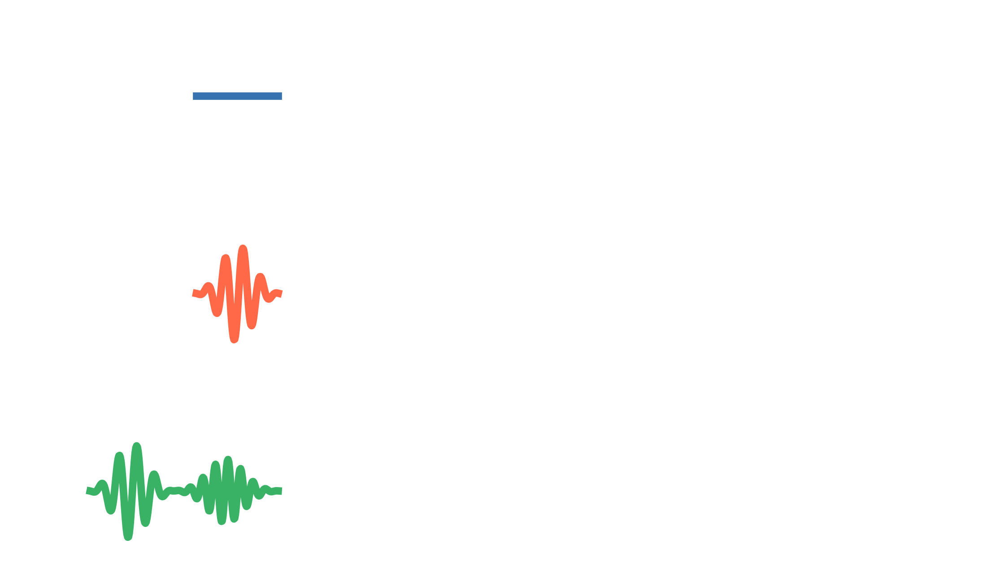

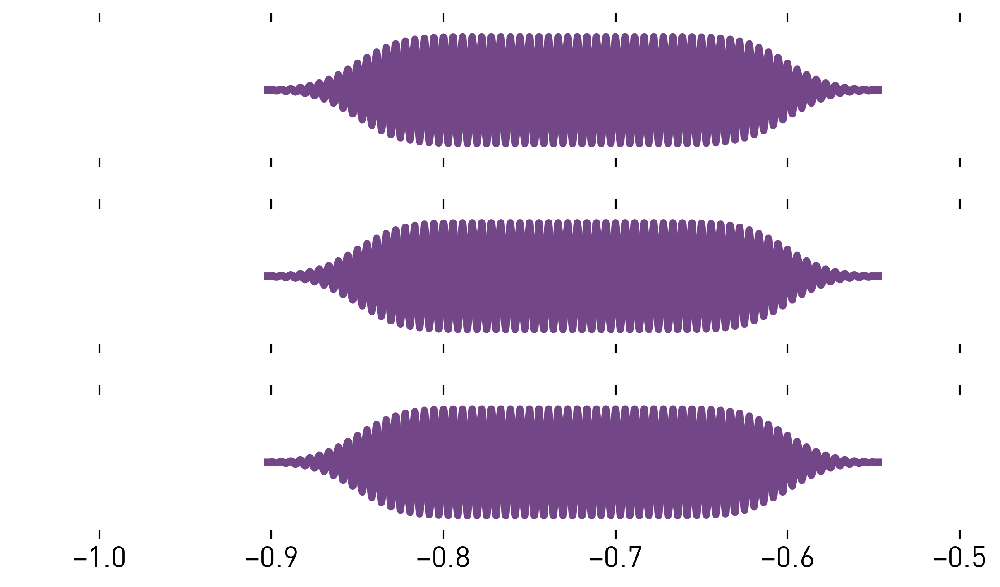

In [152]:
channel_map = dict(qb1=['AWG8_ch1'])
colors = ['#3673AF','#FF6947', "#39B265", "#734687"]
fig1, axes = plt.subplots(3, squeeze=False, sharex=True, sharey=True)
for s, ax, c in zip(seq.segments.values(), axes.flatten(), colors):
    ax.set_prop_cycle(color=[c])
    s.plot(axes=np.array([[ax]]), channel_map=channel_map, legend=False, frameon=False, demodulate=False, 
          plot_kwargs=plot_kwargs)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_yticks([])
    ax.set_xticks([])
    ax.patch.set_alpha(0)
    ax.set_ylim([-0.4,0.4])
    ax.set_xlim([-1.05,-0.5])
fig1.suptitle("")


channel_map = dict(qb1=['UHF_ch1'])
color=['#734687']
fig2, axes = plt.subplots(3, squeeze=False, sharex=True, sharey=True)
for s, ax in zip(seq.segments.values(), axes.flatten()):
    ax.set_prop_cycle(color=color)
    s.plot(axes=np.array([[ax]]), channel_map=channel_map, legend=False, frameon=False, demodulate=False, 
          plot_kwargs=plot_kwargs)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_yticks([])
    ax.patch.set_alpha(0)
#     ax.set_xticks([])
    ax.set_xlim([-1.05,-0.5])
    ax.set_ylim([-0.05,0.05])
fig2.suptitle("")
#     ax.set_ylim([-0.05, 0.5])

In [154]:
fig1.savefig(figsave_base + "ch3_readout_active_reset_pulses0_{:%Y%m%d_%H%M%S}.png".format(datetime.datetime.now()),
            transparent=True)
fig2.savefig(figsave_base + "ch3_readout_active_reset_pulses1_{:%Y%m%d_%H%M%S}.png".format(datetime.datetime.now()),
            transparent=True)

Text(0.5, 0.98, '')

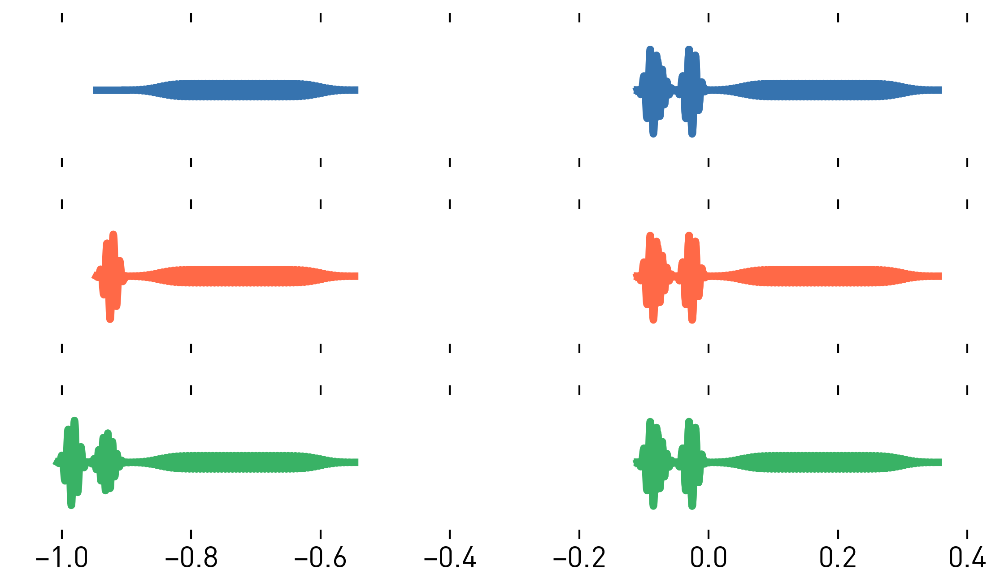

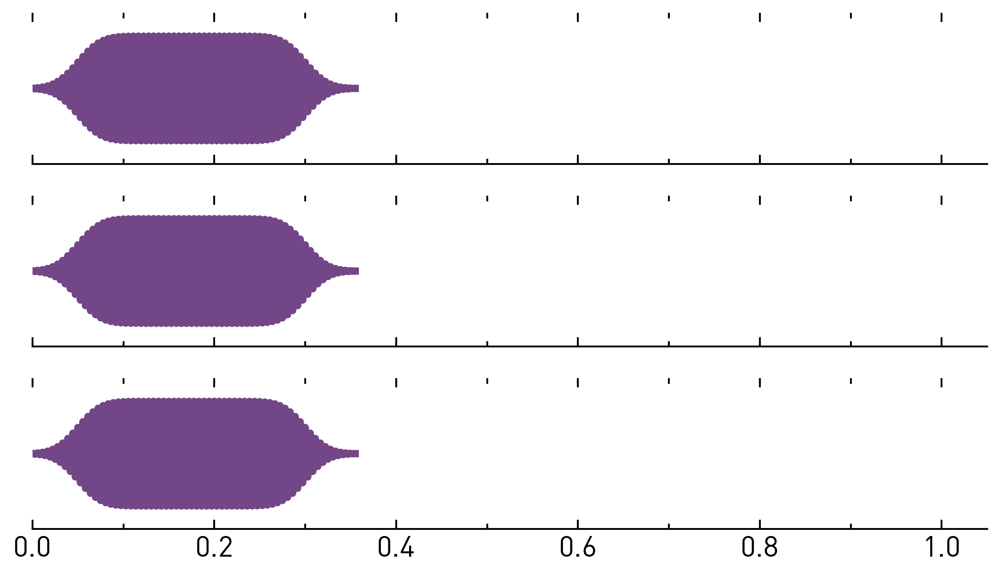

In [149]:
channel_map = dict(qb1=['AWG8_ch1', 'UHF_ch1'])
colors = ['#3673AF','#FF6947', "#39B265", "#734687"]
fig3, axes = plt.subplots(3, squeeze=False, sharex=True, sharey=True)
for s, ax, c in zip(seq.segments.values(), axes.flatten(), colors):
    ax.set_prop_cycle(color=[c])
    s.plot(axes=np.array([[ax]]), channel_map=channel_map, legend=False, frameon=False, demodulate=False, 
          plot_kwargs=plot_kwargs)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_yticks([])
#     ax.set_xticks([])
    ax.set_ylim([-0.4,0.4])
#     ax.set_xlim([-1.05,-0.5])
fig3.suptitle("")


channel_map = dict(qb1=['UHF_ch1'])
color=['#734687']
fig4, axes = plt.subplots(3, squeeze=False, sharex=True, sharey=True)
for s, ax in zip(seq.segments.values(), axes.flatten()):
    ax.set_prop_cycle(color=color)
    s.plot(axes=np.array([[ax]]), channel_map=channel_map, legend=False, frameon=dict(bottom=True, right=False, top=False, left=False), demodulate=False, 
          plot_kwargs=plot_kwargs)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_yticks([])
    ax.set_xticks([0.1*i for i in range(10)], minor=True )
    ax.set_xlim([0,1.05])
    ax.set_ylim([-0.05,0.05])
fig4.suptitle("")
#     ax.set_ylim([-0.05, 0.5])

In [150]:
fig4.savefig(figsave_base + "ch3_readout_active_reset_pulses_axis_{:%Y%m%d_%H%M%S}.png".format(datetime.datetime.now()))

# Threshold Calibration

In [10]:
reload(ra)
# load calibration SSQTRO
tps = ["20191122_152229", "20191122_152250", "20191122_152308"]
thresholded = False
options = dict(pre_selection=True, classif_method='gmm' if not thresholded else 'threshold', show=False, classif_kw=dict(), 
               hist_scale="linear")
ssqtro = ra.Singleshot_Readout_Analysis_Qutrit(t_start =tps,
                                               levels='gef',
                                               options_dict=options, auto=False)
ssqtro.extract_data()
ssqtro.process_data()

if not thresholded:
    pass
mtx_to_invert = ssqtro.proc_data_dict["analysis_params"]['state_prob_mtx_masked']

print(ssqtro.proc_data_dict['analysis_params']['state_prob_mtx_masked'])

[[9.98523523e-01 6.67448728e-04 8.09028761e-04]
 [1.42435156e-02 9.85028123e-01 7.28361591e-04]
 [9.40832962e-03 1.81880855e-02 9.72403585e-01]]


In [7]:
# prepare plot
# shots_to_plot = ssqtro.proc_data_dict['data_masked']['X'][::4, :]
# shot_labels = ssqtro.proc_data_dict['data_masked']['prep_states'][ ::4]
shots_to_plot = []
shot_labels = []
n_shots_per_state = 10000
for state in np.unique(ssqtro.proc_data_dict['data_masked']['prep_states']):
    shots_to_plot_state_i = []
    shots, labels = iter(ssqtro.proc_data_dict['data_masked']['X']), iter(ssqtro.proc_data_dict['data_masked']['prep_states'])
    while len(shots_to_plot_state_i) < n_shots_per_state:
        try:
            s, l = next(shots), next(labels)
            if l == state:
                shots_to_plot_state_i.append(s)
                shot_labels.append(l)
        except Exception as e:
            raise e
            print(f"Only {len(shots_to_plot_state_i)} shots found for state {state}")
            break
    shots_to_plot.extend(shots_to_plot_state_i)
    
shots_to_plot = np.array(shots_to_plot)
shot_labels = np.array(shot_labels)
if  thresholded:
    thresholds =    ssqtro.proc_data_dict['analysis_params']['classifier_params']['thresholds']
else:
    means = ssqtro.proc_data_dict['analysis_params']['classifier_params']['means_']
    covariances = [ssqtro.proc_data_dict['analysis_params']['classifier_params']['covariances_'] for _ in range(3)]

colors = ['#3673AF','#FF6947', "#39B265"]
cmap = matplotlib.colors.ListedColormap(colors)


In [8]:
# Note 08/03: I had modified the readout analysis to allow to pass 
# custom colors for histograms on the side, fix the bin width and 
# put frames on side plots but somehow this does not appear here. Either on other branch or only on backup of computer.

0.0 10000
1.0 10000
2.0 10000


NameError: name 'means' is not defined

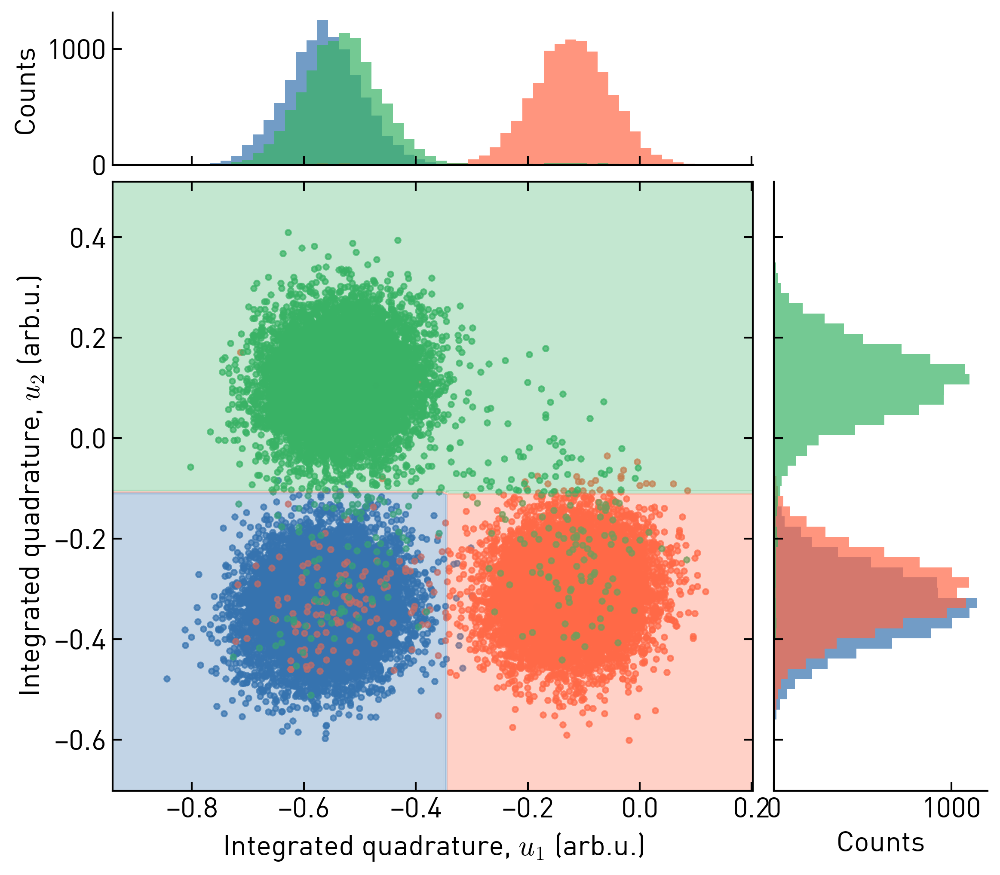

In [9]:
fig, ax = plt.subplots(figsize=(8,7))
kwargs = dict(fig=fig, scale="linear", show=False, frameon=True, colors=colors, 
              alpha=0.7)
fig = ssqtro.plot_scatter_and_marginal_hist(shots_to_plot,shot_labels, **kwargs)
axes = fig.get_axes()
# axes[0].set_aspect('equal')
# axes[1].spines["top"].set_visible(frameon.get("top", True))
# axes[1].spines["right"].set_visible(frameon.get("right", True))
axes[1].spines["top"].set_visible(False)
axes[1].spines["right"].set_visible(False)
axes[1].yaxis.set_tick_params(right=False)
axes[1].xaxis.set_tick_params(right=False, top=False)

axes[2].spines["top"].set_visible(False)
axes[2].spines["right"].set_visible(False)
axes[2].yaxis.set_tick_params(right=False, top=False)
axes[2].xaxis.set_tick_params(right=False, top=False)

axes[0].set_xlabel('Integrated quadrature, $u_1$ (arb.u.)')
axes[0].set_ylabel('Integrated quadrature, $u_2$ (arb.u.)')

plt.subplots_adjust(wspace=0.05, hspace=0.05*7/8)

# add kde
# from scipy import stats

# kde_x = stats.gaussian_kde(shots_to_plot[:, 0], )
# xx = np.linspace(-0.9, 0.2, 1000)
# axes[2].plot(xx, kde_x(xx)*500)



# add background
ssqtro.plot_clf_boundaries(shots_to_plot, ssqtro.clf_, ax=axes[0], cmap=cmap)
for m, cov in zip(means, covariances):
    ssqtro.plot_std(m, cov, n_std=1, ax=axes[0], edgecolor='w', linestyle='--', linewidth=2)
    axes[0].scatter([m[0]], [m[1]], color='w')
#     ssqtro.plot_std(m, cov, n_std=2, ax=axes[0], edgecolor='w', linestyle='--', linewidth=1.5)
#     ssqtro.plot_std(m, cov, n_std=3, ax=axes[0], edgecolor='w', linestyle='--', linewidth=1.5)

# add thresholds
if thresholded:
    axes[0].axvline(thresholds[0], linestyle='--', color='k')
    axes[0].axhline(thresholds[1], linestyle='--', color='k')
    axes[0].text(-0.85, -0.65,"0b00", color=colors[0], weight='bold')
    axes[0].text(0.05, -0.65,"0b01", color=colors[1], weight='bold')
    axes[0].text(-0.85, 0.35,"0b10", color=colors[2], weight='bold')
    axes[0].text(0.05, 0.35, "0b11",color=colors[2], weight='bold')
# axes[1].set_xlim([0,100])

In [109]:
fig.savefig(figsave_base + "ch3_readout_active_reset_scatter_and_hist_{:%Y%m%d_%H%M%S}.png".format(datetime.datetime.now()),
            transparent=False)

# Threshold sweep

In [11]:
# calibration measurement to obtain inversion matrix
tps = ["20191122_152229", "20191122_152250", "20191122_152308"]
# tps = ["20191122_150511", "20191122_150529", "20191122_150546"]
options = dict(pre_selection=True, classif_method='gmm', show=False, classif_kw=dict(), 
               hist_scale="linear")
ssqtro = ra.Singleshot_Readout_Analysis_Qutrit(t_start =tps,
                                               levels='gef',
                                               options_dict=options)
mtx_to_invert = ssqtro.proc_data_dict["analysis_params"]['state_prob_mtx_masked']

0.0 50000
1.0 50000
2.0 50000
0.0 49442
1.0 49426
2.0 49318


## No reset 

In [14]:
t="20191122_154619" 
states = 'gef'
a = ma.MeasurementAnalysis(auto=False, timestamp=t)
a.get_naming_and_values()
reps = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['reset_reps']
ro_separation = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['ro_separation']
post_ro_wait = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['post_ro_wait']
ro = (reps + 1)*len(states)
if ssqtro.classif_method == "threshold": # thresholding has no real probability output so using counts
    p_per_ro_no_reset = []
    shots = np.asarray([a.measured_values.T[i::ro, :] for i in range(ro)])
    nshots = shots.shape[1]
    for r in range(ro):
        classified_shots = ssqtro.clf_.predict(shots[r])
        _, counts = np.unique(classified_shots, return_counts=True)
        p_per_ro_no_reset.append(counts/nshots)
    p_per_ro_no_reset = np.asanyarray(p_per_ro_no_reset)
else:
    probas = ssqtro.clf_.predict_proba(a.measured_values.T)
    p_per_ro_no_reset = np.asarray([np.mean(probas[i::ro], axis=0) for i in range(ro)])
inverted_probas_no_reset = (np.linalg.inv(mtx_to_invert).T @ p_per_ro_no_reset.T).T

c:\users\nathan\code\quantumsoftware\pycqed_py3\pycqed\analysis\measurement_analysis.py:277: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\code\quantumsoftware\pycqed_py3\pycqed\measurement\hdf5_data.py:282: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



In [12]:
def std_error(p, nshots=10000):
    return np.sqrt(np.abs(p)*(1-np.abs(p))/nshots)
def align_axis(ax1, ax2, scale=1, off=0):
    """adjust ax2 xlimits so that ax2 is aligned to ax1 with scaling factor and offset"""
    minx1, maxx1 = ax1.get_xlim()
    ax2.set_xlim(minx1*scale + off, maxx1*scale+off)
def filter_shot(shot_read_out_n_times, n_ro_per_state, n_states):
    use_shot = [True]*n_states
    for s in range(n_states):
        shot_per_state = shot_read_out_n_times[s*n_ro_per_state: (s+1)*n_ro_per_state]
        clf_e_or_f = np.where(shot_per_state != 0)[0]
        clf_g = np.where(shot_per_state == 0)[0]
        if len(clf_g) != 0 and len(clf_e_or_f) > 0:
            if np.any(clf_e_or_f > clf_g[0]):
                use_shot[s] = False
                #return use_shot
    return use_shot
def post_select(probas, n_ro_per_states, n_states):
    mask = []
    for i in range(shots):
        mask.append(filter_shot(shot_clf[:,i], 26, 3))
    mask_all = np.all(mask, axis=1)  

c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning:

Mean of empty slice.



e nan
f nan


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning:

Mean of empty slice.



e nan
f nan


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning:

Mean of empty slice.

c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



e nan
f nan


c:\users\nathan\masterthesis\code\env\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning:

Mean of empty slice.



e nan
f nan


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



e -0.0006633359561993583
f -0.003716389225670061


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



e 0.029636406425925965
f 0.010991821698198602


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



e 0.02990015105831983
f 0.019655089631878113


c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has bee

e 0.03059715862135746
f 0.019704132551423233


c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



e 0.032079379167269835
f 0.020379733516067543


c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.031456667633646074
f 0.0200743436124171


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.038016769496753394
f 0.02079889315254171


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.04481863361296819
f 0.02283040399362616


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



e 0.06438027885692911
f 0.022245611180861807


c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.12236977806265116
f 0.020091024036540138


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.2127433546826292
f 0.027686787927706586


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.3507433561363936
f 0.025610321890339276


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.5133977892471939
f 0.030705162618235807


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.6653419029027035
f 0.03334400744910574


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.7968282131308333
f 0.03901138200196588


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.8681061769824762
f 0.034367471299212686


c:\users\nathan\masterthesis\code\env\lib\site-packages\h5py\_hl\dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\masterthesis\code\env\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



e 0.9131656263695273
f 0.03388841745230935


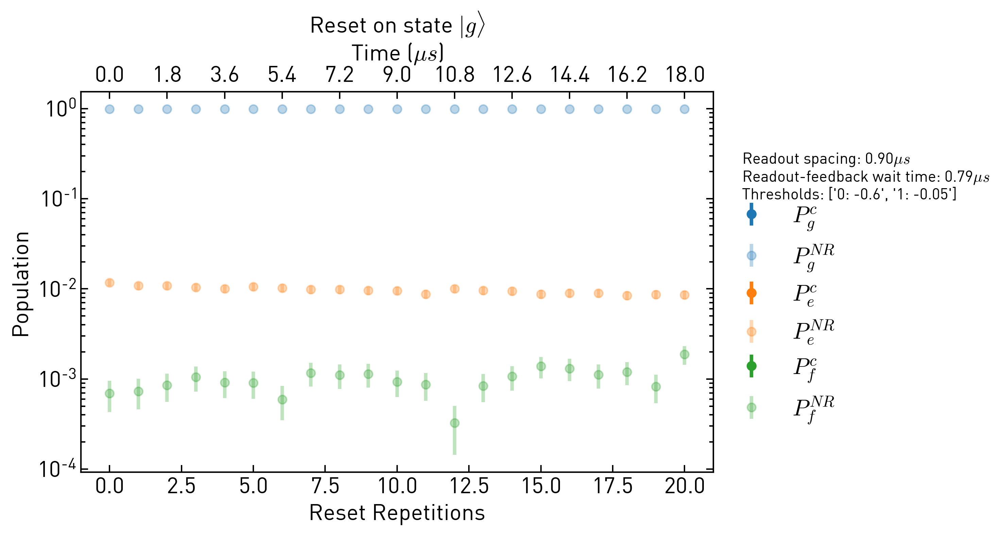

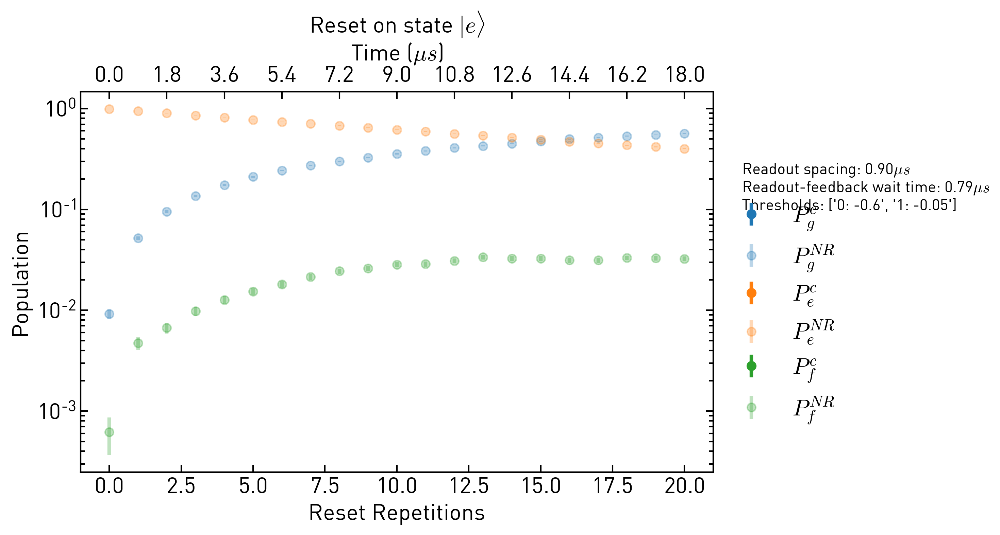

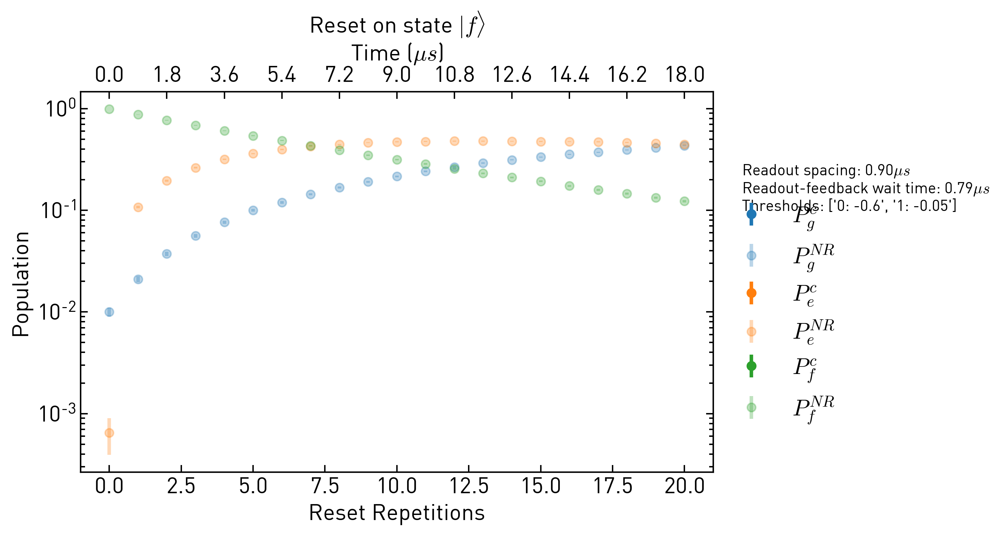

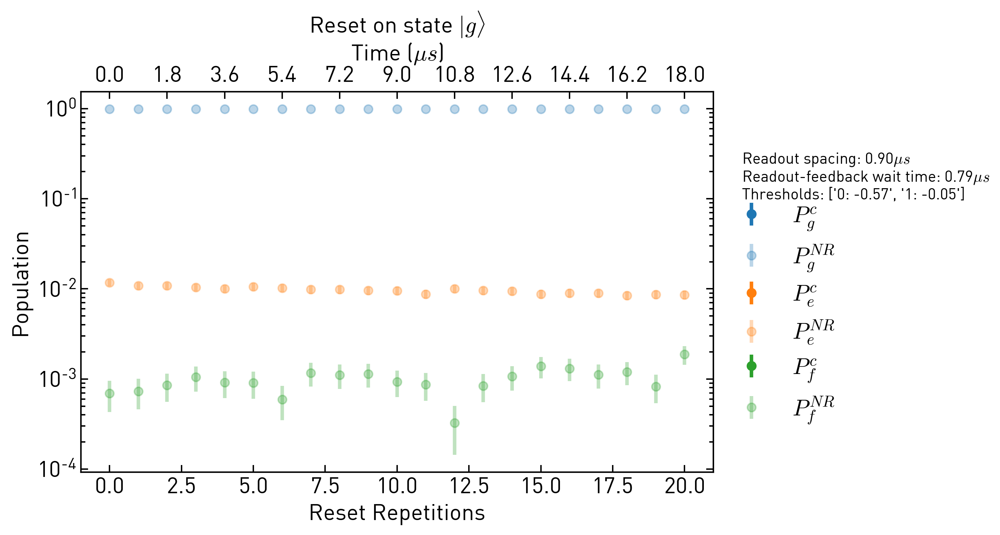

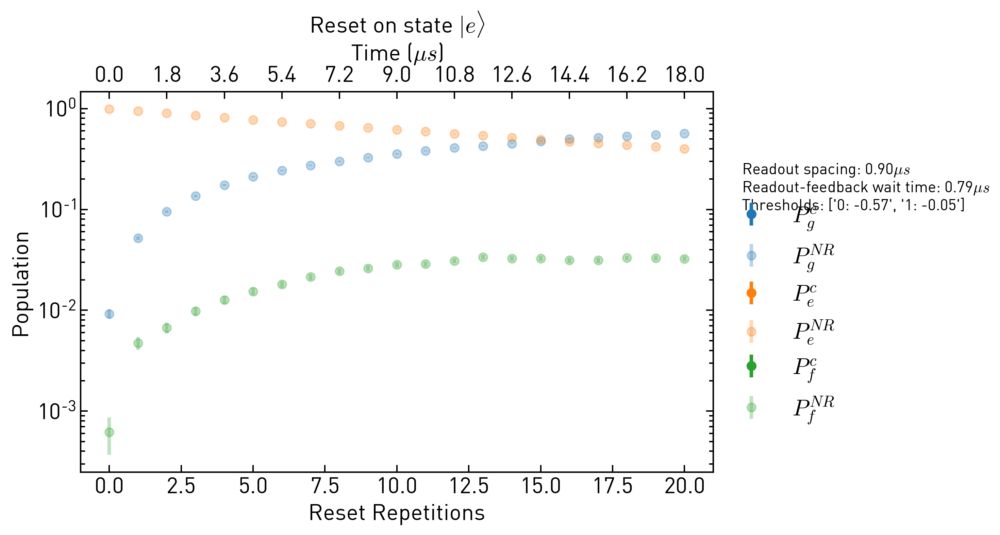

...

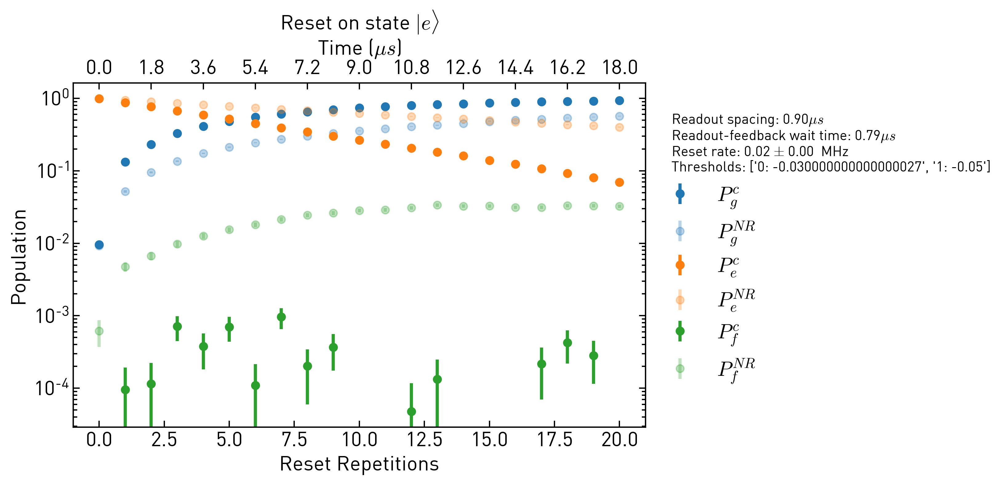

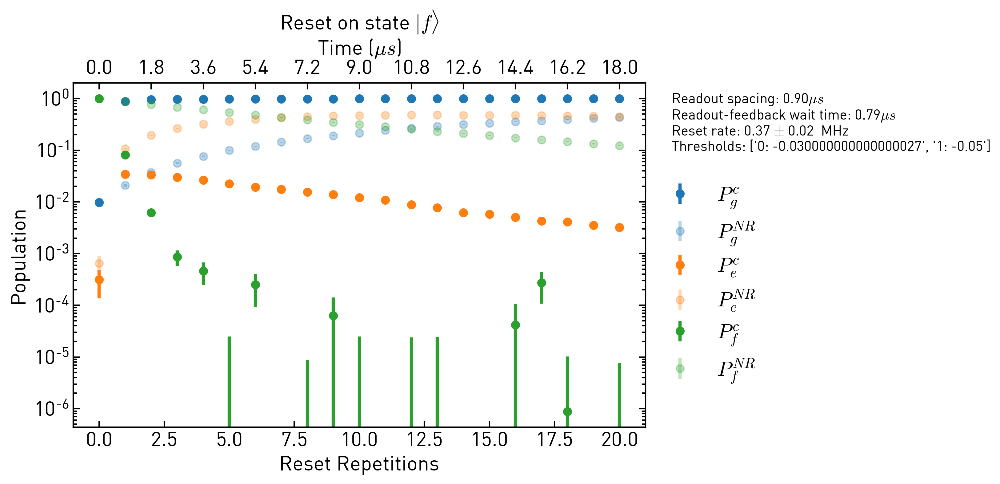

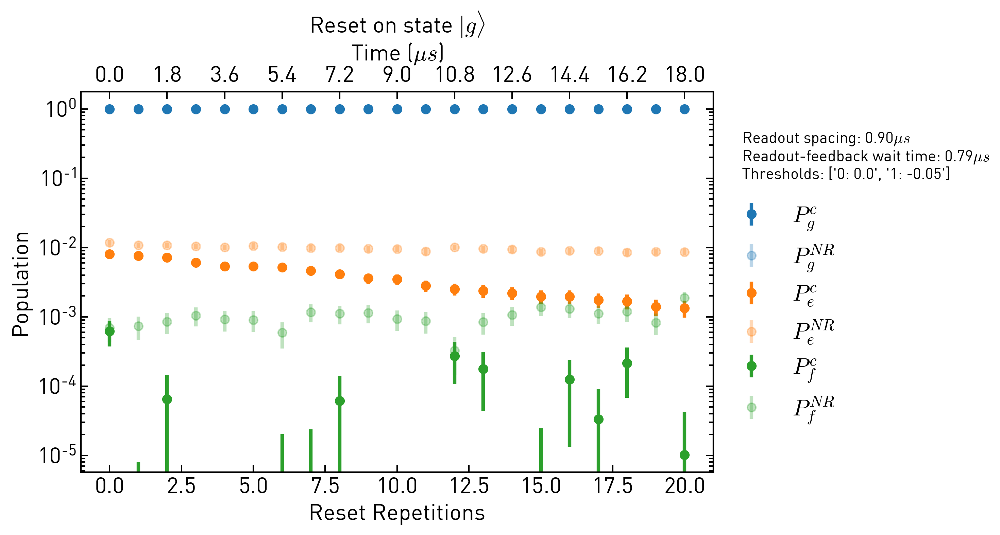

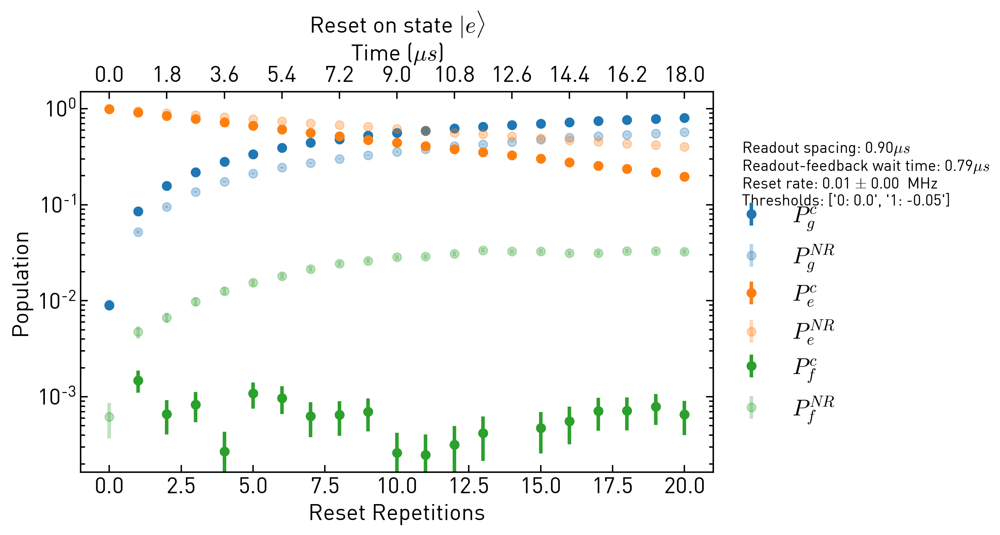

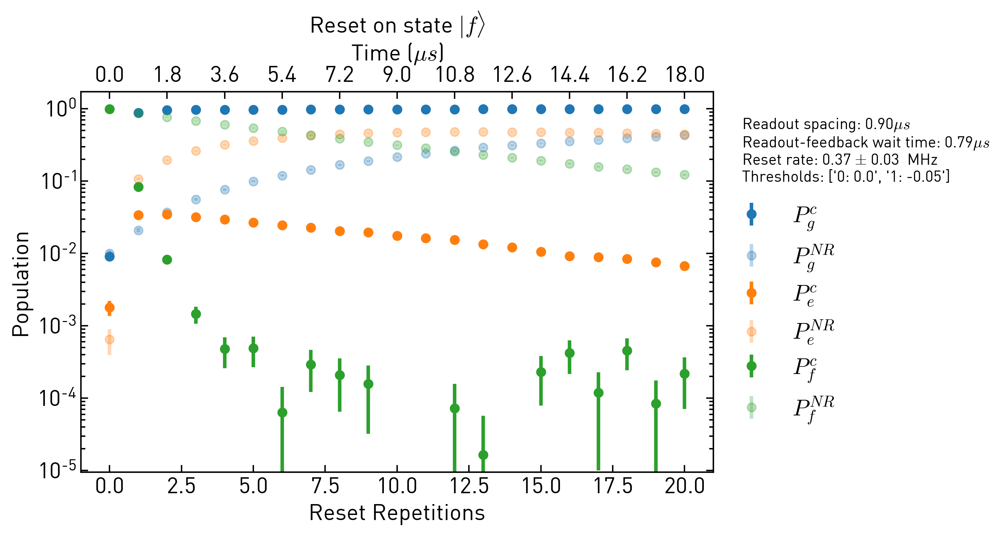

In [151]:
reload(ra)
states = 'gef'
t_start_tend = ["20191122_152443", "20191122_153327"] # axis 0
plot_decay = False
plot = True
save = False
post_select = False
invert_probas = True
show_no_reset = True
tps = a_tools.get_timestamps_in_range(t_start_tend[0], t_start_tend[1])
a = ma.MeasurementAnalysis(auto=False, timestamp=tps[0])
reps = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['reset_reps']
ro_separation = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['ro_separation']
post_ro_wait = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['post_ro_wait']
ro = (reps + 1)*len(states)
rates = []
rates_std = []
residual_pop = []
residual_pop_std = []

for t in tps:
    a = ma.MeasurementAnalysis(timestamp=t, auto=False)
    a.get_naming_and_values()
    t0 = eval(a.data_file["Instrument settings"]["UHF"].attrs["qas_0_thresholds_0_level"])
    t1 = eval(a.data_file["Instrument settings"]["UHF"].attrs["qas_0_thresholds_1_level"])
    probas = ssqtro.clf_.predict_proba(a.measured_values.T)
    p_per_ro = np.asarray([np.mean(probas[i::ro], axis=0) for i in range(ro)])
    inverted_probas = (np.linalg.inv(mtx_to_invert).T @ p_per_ro.T).T
    nshots= probas.shape[0]//ro
    # post selection

    if post_select:
        shot_clf = np.argmax(np.asarray([probas[i::ro] for i in range(ro)]), axis=-1).copy()
        mask = []
        for i in range(nshots):
            mask.append(filter_shot(shot_clf[:,i], ro//len(states), len(states)))
        mask_all = np.all(mask, axis=1)  
        p_per_ro = np.asarray([np.mean(probas[i::ro][mask_all], axis=0) for i in range(ro)])
        inverted_probas = (np.linalg.inv(mtx_to_invert).T @ p_per_ro.T).T 
    
    # plot and save
    if invert_probas:
        mtx_to_plot = inverted_probas
    else:
        mtx_to_plot = p_per_ro
    if invert_probas:
        mtx_to_plot2 = inverted_probas_no_reset
    else:
        mtx_to_plot2 = p_per_ro_no_reset
    yscale = "log"
    for i, s in enumerate(states):
        if plot:
            fig, ax = plt.subplots()
            ax.set_title(r"Reset on state $|{}\rangle$".format(s))
        rate = 0

        for ii,ss in enumerate(states):
            if plot:
                label = "$P_{}^{{{}}}$"
    #             ax.plot(np.arange(ro//3), mtx_to_plot[i*ro//3:(i+1)*ro//3,ii], f'C{ii}o-', label=label.format(ss, "c"))
                ax.errorbar(np.arange(ro//len(states)), mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii], 
                            std_error(mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii], nshots),
                           color=f'C{ii}', label=label.format(ss, "c" if invert_probas else "m"), fmt=" ", marker="o")

                if show_no_reset:
        #                 ax.plot(np.arange(ro//3), mtx_to_plot2[i*ro//3:(i+1)*ro//3,ii], f'C{ii}o-', alpha=0.3, label=label.format(ss, "m"))
                    ax.errorbar(np.arange(ro//len(states)), 
                                   mtx_to_plot2[i*ro//len(states):(i+1)*ro//len(states),ii], 
                                   std_error(mtx_to_plot2[i*ro//len(states):(i+1)*ro//len(states),ii], nshots),
                                   color=f'C{ii}', alpha=0.3, label=label.format(ss, "NR"), fmt=" ",  marker="o")

                ax.set_xlabel('Reset Repetitions')
                ax.set_ylabel('Population')
            if ss == s and s != 'g':
                print(ss,mtx_to_plot[i*ro//len(states)+1, 1])
                residual_pop.append(mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii])
                decay= 1 - mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),0]
                time=np.array([ro_separation*i for i in range(reps + 1)])
                try:
                    fit_res = lmfit.Model(lambda time, rate: np.exp(-2*np.pi*rate*time)).fit(time=time, data=decay, rate=1e5)

                    plot_times = np.linspace(0, time[-1], 100)
                    if plot_decay:
                        ax.plot(plot_times/ro_separation,
                                fit_res.model.func(plot_times, **fit_res.best_values), color='r', label='decay fit')
                    rate = fit_res.params['rate'].value*1e-6
                    rates.append(rate)
                    stderr = fit_res.params['rate'].stderr*1e-6
                    rates_std.append(stderr)
                except Exception as e:
                    rates.append(np.nan)
                    rates_std.append(np.nan)
        if plot:
            ax.legend(loc=(1.01,0.1))
            ax.set_yscale(yscale)
            prep_param_str = "Readout spacing: {:.2f}$\mu s$\nReadout-feedback wait time: {:.2f}$\mu s${}\nThresholds: {}"
            ax.text(reps*1.1,0.1, prep_param_str.format(ro_separation*1e6, 
                                               post_ro_wait*1e6, 
                                              f"\nReset rate: {rate:0.2f} $\\pm$ {stderr:.2f}  MHz" if rate != 0 else "",
                                               [f"{i}: {thr}"  for i, thr in zip([0,1], [t0,t1])]),
               size=11)
            timeax = ax.twiny()
            timeax.set_xticks(np.arange(0,ro//len(states),2)*ro_separation*1e6)
            timeax.errorbar(np.arange(ro//len(states))*ro_separation*1e6, mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii], 
                        std_error(mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii], nshots), label="None", alpha=0)
            timeax.set_xlabel(r"Time ($\mu s$)")
            align_axis(ax, timeax, ro_separation*1e6)
            if save:
                fig.tight_layout()
                fig.savefig("\\".join([a.folder, "reset_{}_{}.png".format(s, "" if not show_uncorrected else "with_uncorrected_probas")]))
    
#     mtx_to_plot = inverted_probas
#     mtx_to_plot2 = p_per_ro
#     save = False
#     yscale = "log"
#     for i,s in enumerate(states):
#         for show_uncorrected in [True, False]:
#             if plot:
#                 fig, ax = plt.subplots()
#                 ax.set_title(r"Residual excited population on state $|{}\rangle$".format(s))
#             rate = 0
#             if plot:
#                 for ii,ss in enumerate(states):

#                     if ss =='g':
#                         continue
#                     label = "$P_{}^{}$"
#         #             ax.plot(np.arange(ro//3), mtx_to_plot[i*ro//3:(i+1)*ro//3,ii], f'C{ii}o-', label=label.format(ss, "c"))
#                     ax.scatter(np.arange(ro//len(states)), mtx_to_plot[i*ro//3:(i+1)*ro//len(states),ii], color=f'C{ii}', label=label.format(ss, "c"))
#                     residual_pop.append(mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii])
#                     if show_uncorrected:
#         #                 ax.plot(np.arange(ro//3), mtx_to_plot2[i*ro//3:(i+1)*ro//3,ii], f'C{ii}o-', alpha=0.3, label=label.format(ss, "m"))
#                         ax.scatter(np.arange(ro//len(states)), mtx_to_plot2[i*ro//3:(i+1)*ro//len(states),ii], color=f'C{ii}', alpha=0.3, label=label.format(ss, "m"))

#                     ax.set_xlabel('Reset Repetitions')
#                     ax.set_ylabel('Population')
#                 ax.legend(loc=[1.01,0.6])
#                 ax.set_ylim([1e-5, 1.05])
#                 ax.set_yscale(yscale)
#                 prep_param_str = "Readout spacing: {:.2f}$\mu s$\nReadout-feedback wait time: {:.2f}$\mu s${}\nThresholds: {}"
#                 ax.text(1.1*reps,0.01, prep_param_str.format(ro_separation*1e6, 
#                                                              post_ro_wait*1e6, 
#                                                       f"\nReset rate: {rate:0.2f} $\\pm$ {stderr:.2f}  MHz" if rate != 0 else "",
#                                                        [f"{i}: {thr}"  for i, thr in zip([0,1], [t0, t1])]),
#                        size=11)
#             if save:
#                 fig.tight_layout()
#                 fig.savefig("\\".join([a.folder, "residual_pop_prep_{}_{}.png".format(s, "" if not show_uncorrected else "with_uncorrected_probas")]))
#                 plt.close('all')


c:\users\nathan\code\quantumsoftware\pycqed_py3\pycqed\analysis\measurement_analysis.py:277: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

c:\users\nathan\code\quantumsoftware\pycqed_py3\pycqed\measurement\hdf5_data.py:282: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.








Rate ee: 0.603 +- 0.010
steady state: 0.0015 +- 0.0004




Rate ff: 0.409 +- 0.004
steady state: 0.0017 +- 0.0005


Text(0.5, 0, 'Time, $t$ ($\\mu s$)')

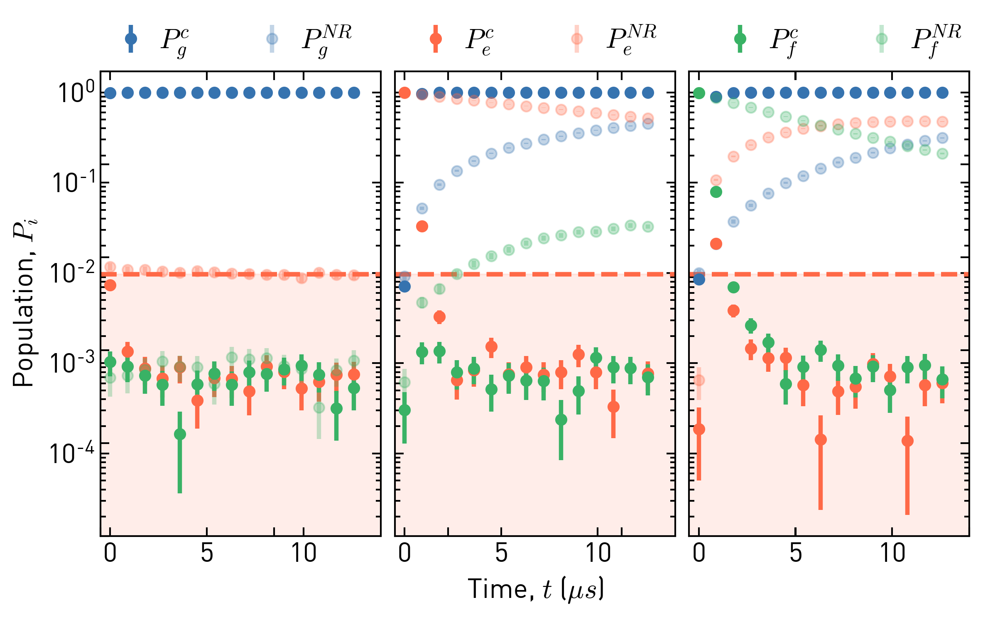

In [17]:
# plot selected timestamp
tps = ['20191122_152840']
plot_up_to = 15
plot = True
save = False
post_select = False
invert_probas = True
show_no_reset = True
plot_thermal_pop = True
plot_decay = False
yscale = "log"
a = ma.MeasurementAnalysis(auto=False, timestamp=tps[0])
reps = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['reset_reps']
ro_separation = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['ro_separation']
post_ro_wait = a.data_file["Experimental Data"]["Experimental Metadata"]["preparation_params"].attrs['post_ro_wait']
ro = (reps + 1)*len(states)
thermal_pop = np.nan
for t in tps:
    a = ma.MeasurementAnalysis(timestamp=t, auto=False)
    a.get_naming_and_values()
    t0 = eval(a.data_file["Instrument settings"]["UHF"].attrs["qas_0_thresholds_0_level"])
    t1 = eval(a.data_file["Instrument settings"]["UHF"].attrs["qas_0_thresholds_1_level"])
    if ssqtro.classif_method == "threshold": # thresholding has no real probability output so using counts
        p_per_ro = []
        shots = np.asarray([a.measured_values.T[i::ro, :] for i in range(ro)])
        nshots = shots.shape[1]
        for r in range(ro):
            classified_shots = ssqtro.clf_.predict(shots[r])
            _, counts = np.unique(classified_shots, return_counts=True)
            p_per_ro.append(counts/nshots)
        p_per_ro = np.asanyarray(p_per_ro)
    else:
        probas = ssqtro.clf_.predict_proba(a.measured_values.T)
        p_per_ro = np.asarray([np.mean(probas[i::ro], axis=0) for i in range(ro)])
    inverted_probas = (np.linalg.inv(mtx_to_invert).T @ p_per_ro.T).T
    nshots= probas.shape[0]//ro
    # post selection

    if post_select:
        shot_clf = np.argmax(np.asarray([probas[i::ro] for i in range(ro)]), axis=-1).copy()
        mask = []
        for i in range(nshots):
            mask.append(filter_shot(shot_clf[:,i], ro//len(states), len(states)))
        mask_all = np.all(mask, axis=1)  
        p_per_ro = np.asarray([np.mean(probas[i::ro][mask_all], axis=0) for i in range(ro)])
        inverted_probas = (np.linalg.inv(mtx_to_invert).T @ p_per_ro.T).T 
    
    # plot and save
    if invert_probas:
        mtx_to_plot = inverted_probas
    else:
        mtx_to_plot = p_per_ro
    if invert_probas:
        mtx_to_plot2 = inverted_probas_no_reset
    else:
        mtx_to_plot2 = p_per_ro_no_reset

    fig, ax = plt.subplots(ncols=3, sharey=True, figsize=(9,fig_size[1]))
    for i, s in enumerate(states):
        rate = 0
        for ii,ss in enumerate(states):
            label = "$P_{}^{{{}}}$"
#             print( mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii][:plot_up_to])
            ax[i].errorbar(np.arange(ro//len(states))[:plot_up_to]*ro_separation*1e6, 
                           mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii][:plot_up_to], 
                        std_error(mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii], nshots)[:plot_up_to],
                       color=colors[ii], label=label.format(ss, "c" if invert_probas else "m"), fmt=" ", marker="o")
            if show_no_reset:
                print('')
                ax[i].errorbar(np.arange(ro//len(states))[:plot_up_to]*ro_separation*1e6, 
                               mtx_to_plot2[i*ro//len(states):(i+1)*ro//len(states),ii][:plot_up_to], 
                               std_error(mtx_to_plot2[i*ro//len(states):(i+1)*ro//len(states),ii], nshots)[:plot_up_to],
                               color=colors[ii], alpha=0.3, label=label.format(ss, "NR"), fmt=" ",  marker="o")
            ax[i].set_xlim([-0.5, plot_up_to*ro_separation*1e6 + 0.5])
            # plot thermal pop:
            if s == 'g' and ss == 'e':
                therm_pop = np.mean( mtx_to_plot2[i*ro//len(states):(i+1)*ro//len(states),ii] 
#                                      mtx_to_plot2[i*ro//len(states):(i+1)*ro//len(states),2] # add f level to have total p_exc
                                   )
            if plot_thermal_pop:
                try:
                    ax[i].axhline(therm_pop, linestyle='--', color=colors[1])
                    ax[i].fill_between([-1, plot_up_to+1], [therm_pop]*2, alpha=0.04, color=colors[1])
                except:
                    # fails if not defined yet
                    pass
            
            if ss == s and s != 'g':
#                 print(ss,mtx_to_plot[i*ro//len(states)+1, 1])
                decay= 1 - mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),0]
                time=np.array([ro_separation*i for i in range(reps + 1)])
                try:
                    fit_res = lmfit.Model(lambda time, rate, off: off + (1-off)*np.exp(-2*np.pi*rate*time)).fit(time=time, 
                                                                                                                 data=decay, 
                                                                                                                 rate=1e5,
                                                                                                                off = 0)
                    plot_times = np.linspace(0, time[-1], 100)
                    if plot_decay:
                        ax[i].plot(plot_times/ro_separation,
                                fit_res.model.func(plot_times, **fit_res.best_values), color='r', label='decay fit')
                    rate = fit_res.params['rate'].value*1e-6
                    stderr = fit_res.params['rate'].stderr*1e-6
                    print(f"Rate {s+ss}: {rate:0.3f} +- {stderr:.3f}")
                    print(f"steady state: {fit_res.params['off'].value:.4f} +- {fit_res.params['off'].stderr:.4f}")

                except Exception as e:
                    raise e
                    rates.append(np.nan)
                    rates_std.append(np.nan)
            
#             timeax = ax[i].twiny()
# #             timeax.set_xticks(np.arange(0,ro//len(states),2)*ro_separation*1e6)
#             timeax.errorbar(np.arange(ro//len(states))[:plot_up_to]*ro_separation*1e6, 
#                             mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii][:plot_up_to], 
#                         std_error(mtx_to_plot[i*ro//len(states):(i+1)*ro//len(states),ii], nshots)[:plot_up_to], 
#                             label="None", alpha=0)
#             align_axis(ax[i], timeax, ro_separation*1e6)
        
ax[0].legend(loc=(-0.03,1), ncol=6, handletextpad=0.02)
ax[i].set_yscale(yscale)
plt.subplots_adjust(wspace=0.05)
ax[0].set_ylabel('Population, $P_i$')
# ax[i].set_ylim([0.6e-4, 1.5])

# common xlabel
fig.add_subplot(111, frameon=False)
plt.tick_params(labelcolor='none', top='off', bottom='off', left='off', right='off')
plt.grid(False)
plt.xlabel(r"Time, $t$ ($\mu s$)")


In [152]:
fig.savefig(figsave_base + "ch3_readout_active_reset_residual_populations_{:%Y%m%d_%H%M%S}.png".format(datetime.datetime.now()),
            transparent=False)

## Plot reset rate

e
f
e
f


(6e-05, 1.5)

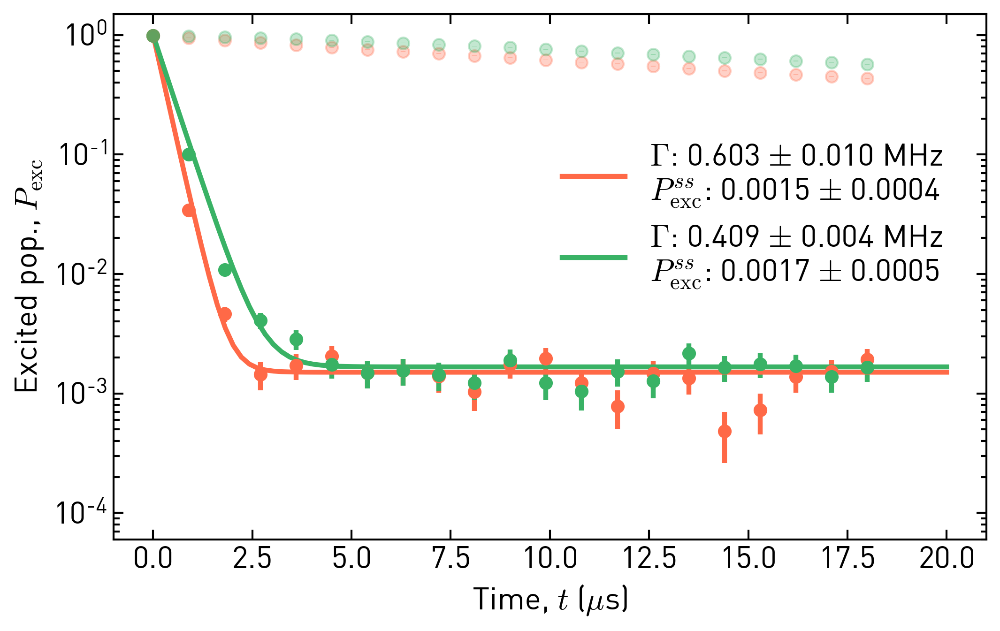

In [67]:

state_prep = ['e', 'f']
fig, ax = plt.subplots()
mtx = inverted_probas
alpha = 1
for i, s in enumerate(states[1:]):
    print(s)
    decay= 1 - mtx[(i+1)*ro//len(states):(i+2)*ro//len(states),0]
    time=np.array([ro_separation*i for i in range(reps +1)])
    try:
        fit_res = lmfit.Model(lambda time, rate, off: off + (1-off)*np.exp(-2*np.pi*rate*time)).fit(time=time, 
                                                                                                     data=decay, 
                                                                                                     rate=1e5,
                                                                                                    off = 0)
#             fit_res = lmfit.Model(lambda time, rate: np.exp(-2*np.pi*rate*time)).fit(time=time,  data=decay, rate=1e5)
        plot_times = np.linspace(0, time[-1], 100)
        rate = fit_res.params['rate'].value*1e-6
        stderr = fit_res.params['rate'].stderr*1e-6
        Pss = fit_res.params['off'].value
        psserr = fit_res.params['off'].stderr
        ax.plot(plot_times/ro_separation,
                fit_res.model.func(plot_times, **fit_res.best_values), '-', alpha=alpha,
                label=f'$\Gamma$: {rate:.3f} $\pm$ {stderr:0.3f} MHz\n$P_{{\mathrm{{exc}}}}^{{ss}}$: {Pss:0.4f} $\pm$ {psserr:0.4f}', color=colors[i+1])
        ax.errorbar(time*1e6, decay, std_error(decay, nshots), fmt=' ',color=colors[i+1], 
                    marker="o", mec=colors[i+1], mfc=colors[i+1], alpha=alpha)
        ax.set_yscale("log")
        ax.set_ylabel(r'Excited pop., $P_{\rm{exc}}$')
        ax.set_xlabel('Time, $t$ ($\mu$s)')
#         ax[i].set_ylim(0.00)
    except Exception as e:
        raise e

mtx = inverted_probas_no_reset
alpha= 0.3
for i, s in enumerate(states[1:]):
    print(s)
    decay= 1 - mtx[(i+1)*ro//len(states):(i+2)*ro//len(states),0]
    time=np.array([ro_separation*i for i in range(reps + 1)])
    try:

#             fit_res = lmfit.Model(lambda time, rate: np.exp(-2*np.pi*rate*time)).fit(time=time,  data=decay, rate=1e5)
#         plot_times = np.linspace(0, time[-1], 100)
#         rate = fit_res.params['rate'].value*1e-6
#         stderr = fit_res.params['rate'].stderr*1e-6
#         Pss = fit_res.params['off'].value
#         psserr = fit_res.params['off'].stderr
#         ax.plot(plot_times/ro_separation,
#                 fit_res.model.func(plot_times, **fit_res.best_values), '-', alpha=alpha,
#                 label=f'$\Gamma$: {rate:.3f} $\pm$ {stderr:0.3f} MHz\n$P_{{\mathrm{{exc}}}}^{{ss}}$: {Pss:0.4f} $\pm$ {psserr:0.4f}', color=colors[i+1])
        ax.errorbar(time*1e6, decay, std_error(decay, nshots), fmt=' ',color=colors[i+1], 
                    marker="o", mec=colors[i+1], mfc=colors[i+1], alpha=alpha)

#         ax[i].set_ylim(0.00)
    except Exception as e:
        raise e
ax.legend(loc=[0.5, 0.45])

ax.set_ylim([0.6e-4, 1.5])


In [70]:
fig.savefig(figsave_base + "ch3_readout_active_reset_fit_{:%Y%m%d_%H%M%S}.png".format(datetime.datetime.now()),
            transparent=False)

## Comparison with Paul's paper

See mathematica script: Q:\USERS\nathan\code\mathematica

## Analysis

In [81]:
t1 =qb1.T1()
thermal_pop = 0.009
uprate = thermal_pop/t1
print(t1, uprate)

2.4011992211986314e-05 374.81271526930516


In [82]:
np.exp(1/(uprate*2*np.pi))

1.0004247154165102

In [15]:
# maximal theoretical rate
1/ro_separation*1e-6

1.111111111111111

In [91]:
# explained by decay between end ro pulse and beginning feedback pulse
t1 = 20
t_ro_end = 0.175
t_fb_pulse = t_ro_end + 0.175+ 0.440 #440 + half of pulse (25ns)
lost_t1_fb_pulse = np.exp(-1/t1*t_fb_pulse)
lost_t1_ro_pulse = np.exp(-1/t1*t_ro_end) 
print(lost_t1_ro_pulse)
print(lost_t1_fb_pulse)
print(lost_t1_fb_pulse - lost_t1_ro_pulse)

0.9912881698401698
0.9612699539905982
-0.03001821584957154


- For e pop of  3.3 % after first reset rep, reset rate of 0.6 MHz (tcycle = 0.9mus). 
- To reach 0.8, would have to have a tcycle of 0.7 mus or e pop 1%
- between the ro pulse and beginning of feedback pulse approximately 1.76% will decay (with t1 = 25).
- remaining 0.66% due to other decays and preparation errors

In [ ]:
qb.acq_length() + uhf_latency + 0.11e-6

In [138]:
mtx = p_per_ro_no_reset #inverted_probas_no_reset #p_per_ro_no_reset
for i, s in enumerate(states):
    print("Prep " + s)
    for ii, ss in enumerate(states):
        print(ss + " pop : " + str(mtx[i*ro//len(states):(i+1)*ro//len(states),ii][:3]), end=' ')
        print(np.diff(mtx[i*ro//len(states):(i+1)*ro//len(states),ii][:2]))

Prep g
g pop : [0.98627537 0.98715341 0.9870391 ] [0.00087804]
e pop : [0.01224492 0.01132726 0.011327  ] [-0.00091766]
f pop : [0.00147971 0.00151933 0.0016339 ] [3.9619869e-05]
Prep e
g pop : [0.02330384 0.06534413 0.10754645] [0.04204029]
e pop : [0.97536708 0.92932421 0.88521414] [-0.04604287]
f pop : [0.00132908 0.00533166 0.00723942] [0.00400258]
Prep f
g pop : [0.01931635 0.03070293 0.04718015] [0.01138659]
e pop : [0.01863935 0.12166421 0.20604025] [0.10302486]
f pop : [0.9620443  0.84763285 0.7467796 ] [-0.11441144]


In [155]:
mtx = p_per_ro #inverted_probas #p_per_ro_no_reset
n = -1
for i, s in enumerate(states):
    print("Prep " + s)
    for ii, ss in enumerate(states):
        print(ss + " pop : " + str(mtx[i*ro//len(states):(i+1)*ro//len(states),ii][:3]), end=' ')
        print(np.diff(mtx[i*ro//len(states):(i+1)*ro//len(states),ii][:3]))

            

Prep g
g pop : [0.99024159 0.99627728 0.99694082] [0.00603569 0.00066354]
e pop : [0.00794407 0.00201713 0.0015435 ] [-0.00592694 -0.00047363]
f pop : [0.00181434 0.00170559 0.00151568] [-0.00010875 -0.00018991]
Prep e
g pop : [0.02123653 0.96471414 0.99394832] [0.94347761 0.02923419]
e pop : [0.97773997 0.03318346 0.0039206 ] [-0.94455651 -0.02926286]
f pop : [0.0010235  0.00210241 0.00213108] [1.07890133e-03 2.86757637e-05]
Prep f
g pop : [0.01779694 0.89900068 0.98784064] [0.88120373 0.08883996]
e pop : [0.01822003 0.02285934 0.00457221] [ 0.00463931 -0.01828713]
f pop : [0.96398302 0.07813998 0.00758715] [-0.88584304 -0.07055284]


In [158]:
# rethermalization
t1 = 24
therm = 0.01 # in p, not %
uprate = therm/t1
downrate = 1/t1 - uprate
# based on 1/t1 = up + down, two level approx
print(uprate)

0.0004166666666666667


DSolve[{z'[t] == -(z[t]/t1ef),
   y'[t] == u x[t] - y[t]/t1ge + z[t]/t1ef,
   x'[t] == -(u x[t]) + y[t]/t1ge,
   x[0] == g0, y[0] == e0, z[0] == f0},
  {x[t], y[t], z[t]}, t] /. {g0 -> 1, e0 -> 0, f0 -> 0, t1ge -> 24, 
  t1ef -> 14, u -> 0.01/24, t -> 0.44}

{{x[0.44] -> 0.999818, y[0.44] -> 0.000181646, z[0.44] -> 0.}}

(81,)
(19,)
(17,)
(14,)
(9756,)
(331,)
(41,)
(14,)
(149,)
(225,)
(46,)
(21,)


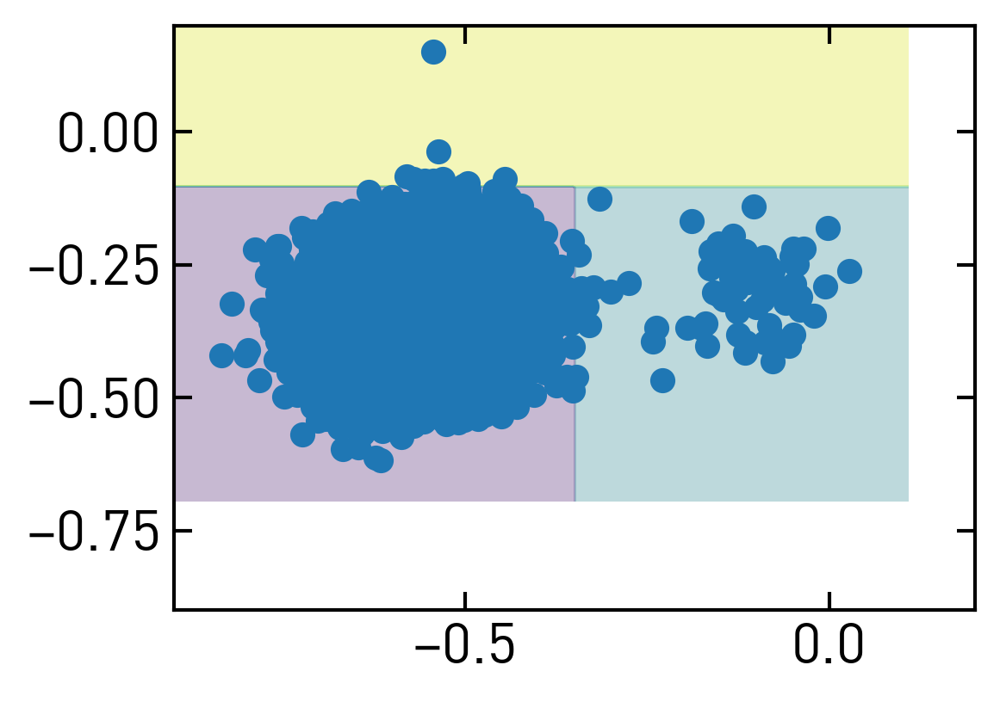

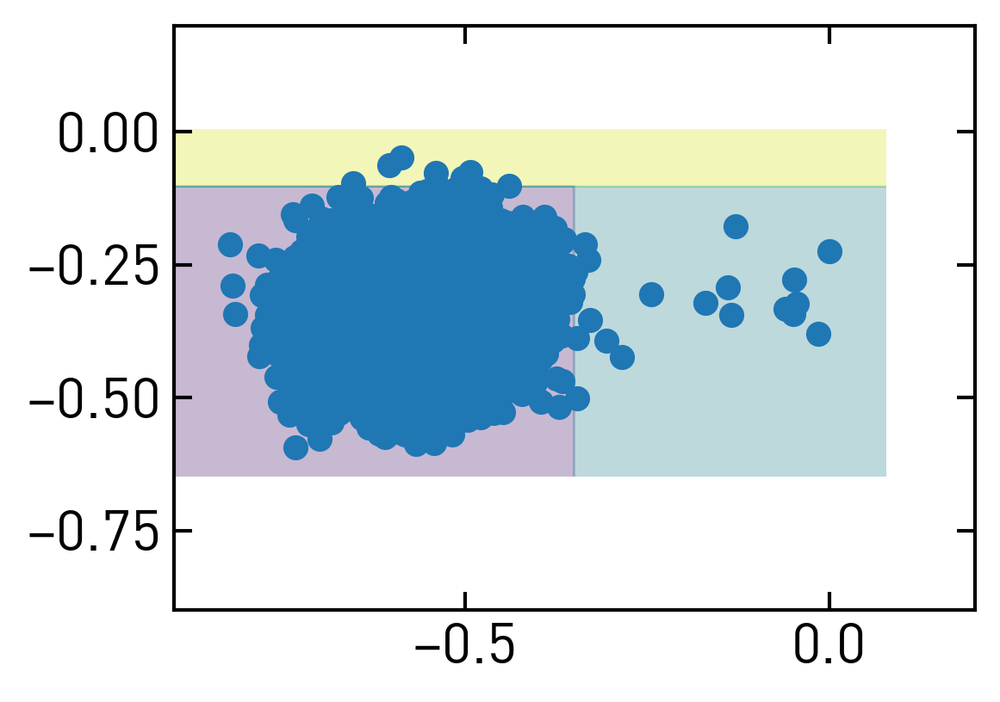

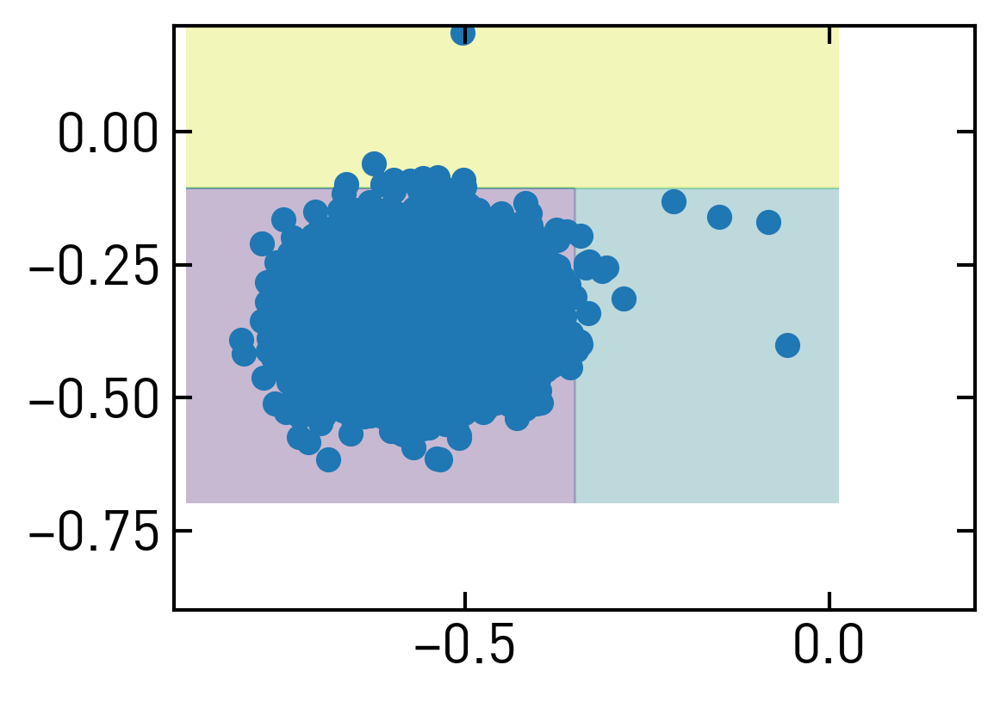

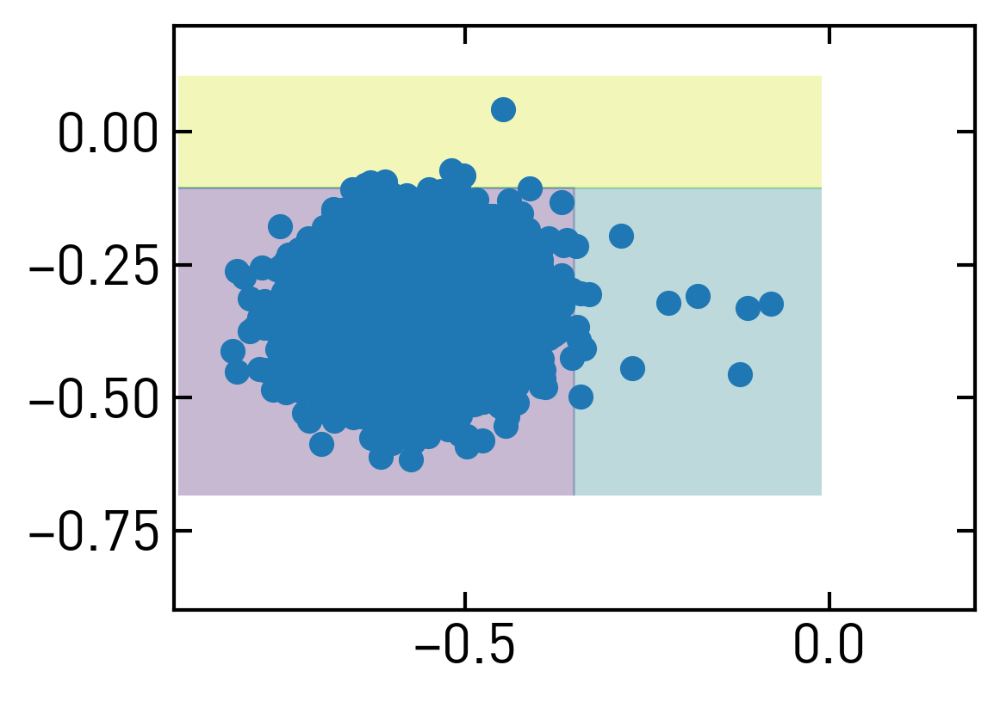

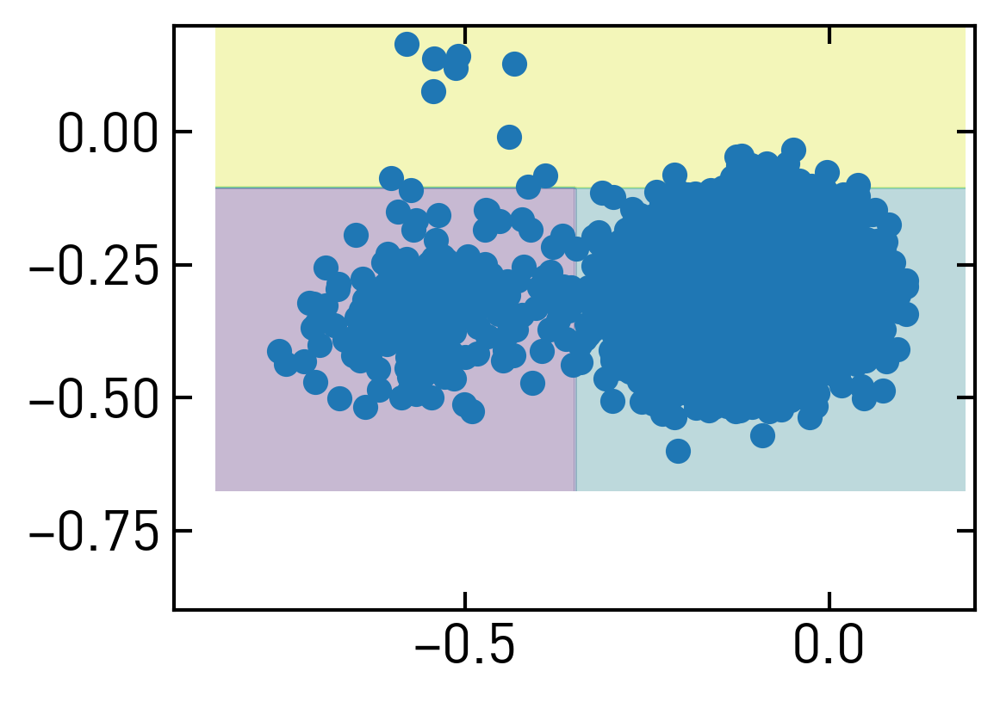

...

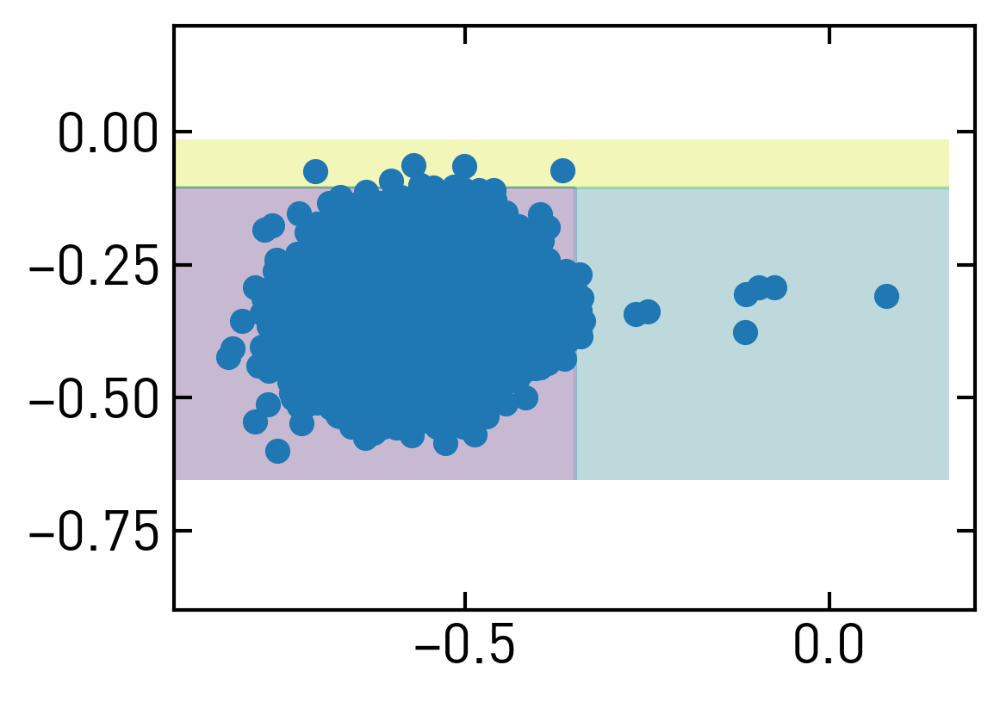

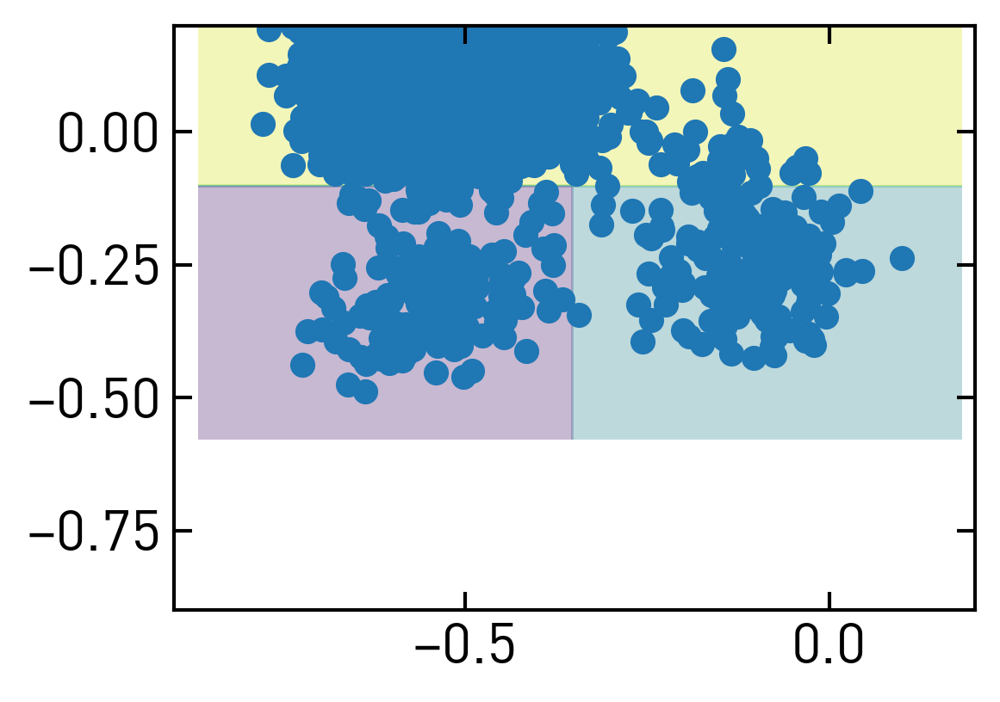

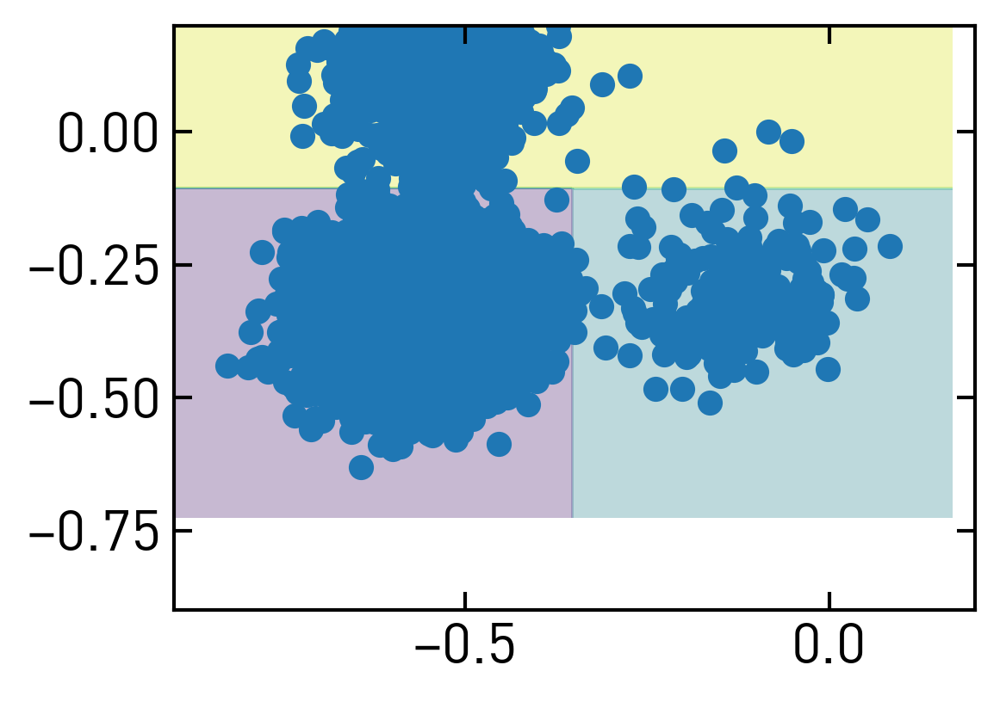

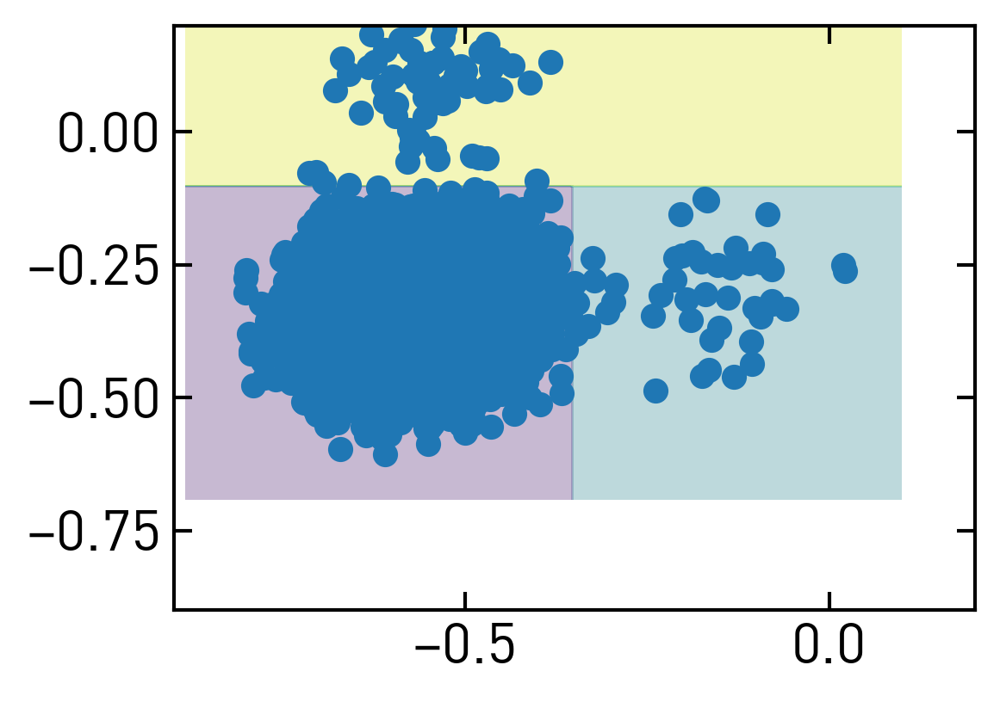

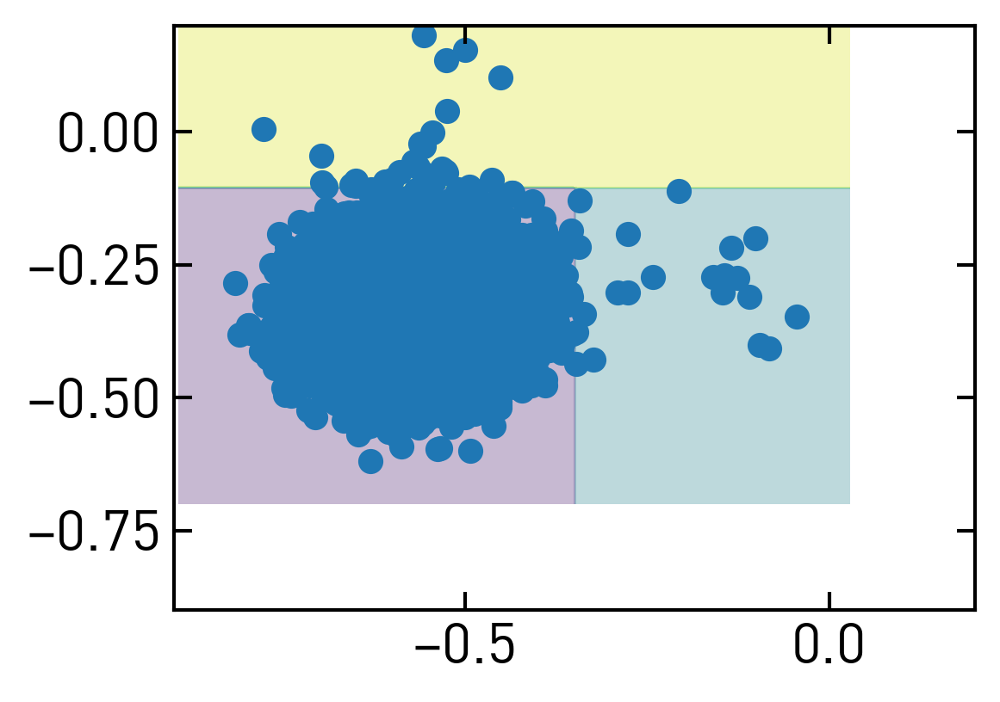

In [65]:
shots = np.asarray([a.measured_values.T[i::ro, :] for i in range(ro)])
crop_ro = 4
for i, s in enumerate(states):
    for r in range(crop_ro):
        fig, ax = plt.subplots( figsize= (4,3))
        ax.set_xlim([-0.9, 0.2])
        ax.set_ylim([-0.9, 0.2])        
        sh = np.squeeze(shots[i*(ro//3)+r: i*(ro//3)+r+1])
        ssqtro.plot_clf_boundaries(sh, ssqtro.clf_, ax=ax)
        
        print(np.where((sh[:, 0] > -0.350830078125)* (sh[:, 1] < -0.103271484375))[0].shape)
        ax.scatter(sh[:, 0], sh[:,1])

# Threshold calibration

In [ ]:
save = False
post_select = post_select
thresholds = thr_axis_1
states='gef'
residual_pop = np.asarray(residual_pop)
for rep in range(8,11):
    for i,s in enumerate(states):
        for ii, pop_state in enumerate('ef'):
            fig, ax = plt.subplots()
            ax.set_title("Reset $|{}\\rangle$".format(s))
            ax.set_ylim([0,1])
            ax.scatter(thresholds, rates[0::2], color='C1', label=r"rate reset $|e\rangle$")
            ax.scatter(thresholds, rates[1::2], color='C2', label=r"rate reset $|f\rangle$")
            ax.plot([], [], color='w', label=f"reset rep.: {rep}")
            ax.set_xlabel("Threshold (V)")
            ax.set_ylabel("Reset rate (MHz)")
            ax_resid = ax.twinx()
            ax_resid.scatter(thresholds, residual_pop[i*4+ii::12, rep], color='purple', marker='x')
            ax_resid.fill_between(thresholds, np.ones_like(thresholds)*-0.01, np.ones_like(thresholds)*0.008, color='purple', alpha=0.1)
            ax_resid.set_yscale('symlog', linthreshy=1e-3)
            ax_resid.set_ylim([-1e-2,1e-0])
            ax_resid.spines['right'].set_color('purple')
            ax_resid.set_ylabel(r"Residual $|{}\rangle$ pop. corrected".format(pop_state))
            ax_resid.yaxis.label.set_color('purple')
            ax_resid.tick_params(axis='y', colors='purple')
            ax.legend()
            if save:
                fig.tight_layout()
                fig.savefig("\\".join([a.folder, 
                                       "rates_vs_thr_reset_{}_p{}{}_rep{}.png".format(s, pop_state, 
                                                                                     "_post_selected" if post_select else "",
                                                                                      rep)]))
                plt.close()

## plot difference

## amplitude sweep

['20191028_181312', '20191028_181329', '20191028_181347']
['20191028_181420', '20191028_181439', '20191028_181457']
['20191028_181529', '20191028_181547', '20191028_181605']
['20191028_181638', '20191028_181656', '20191028_181715']
['20191028_181747', '20191028_181805', '20191028_181823']
['20191028_181855', '20191028_181913', '20191028_181931']
['20191028_182003', '20191028_182021', '20191028_182038']
['20191028_182111', '20191028_182129', '20191028_182146']
['20191028_182219', '20191028_182236', '20191028_182254']
['20191028_182327', '20191028_182344', '20191028_182402']
['20191028_182435', '20191028_182454', '20191028_182512']
['20191028_182544', '20191028_182602', '20191028_182620']
['20191028_182653', '20191028_182711', '20191028_182729']
['20191028_182801', '20191028_182819', '20191028_182837']


KeyboardInterrupt: 

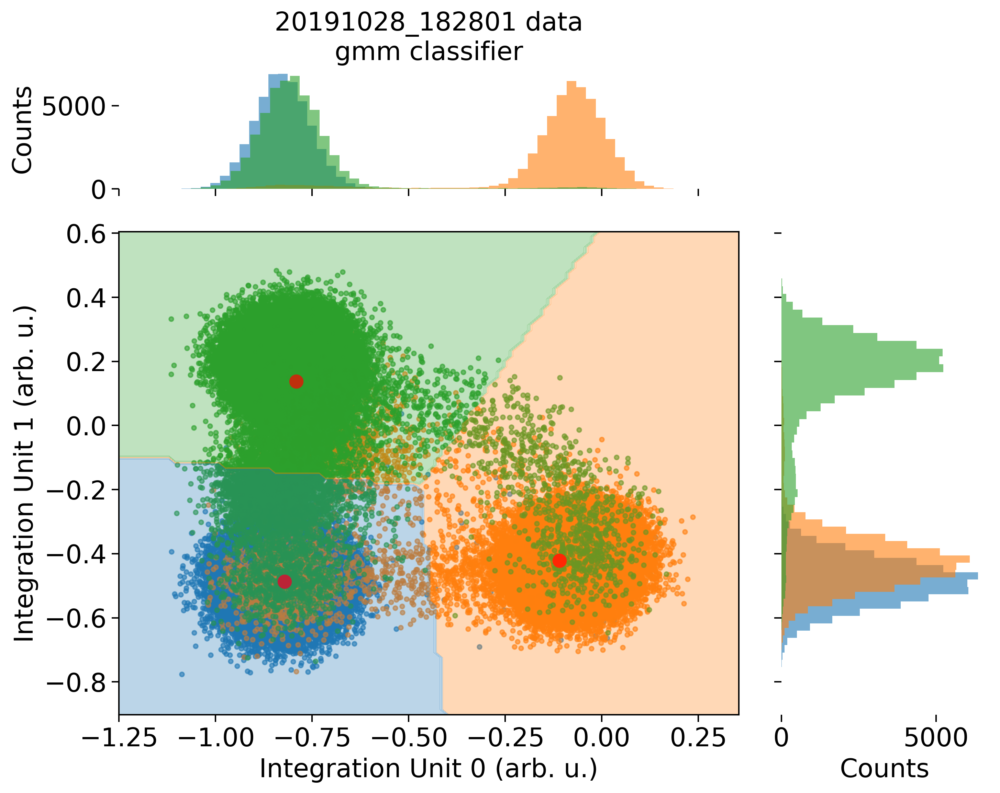

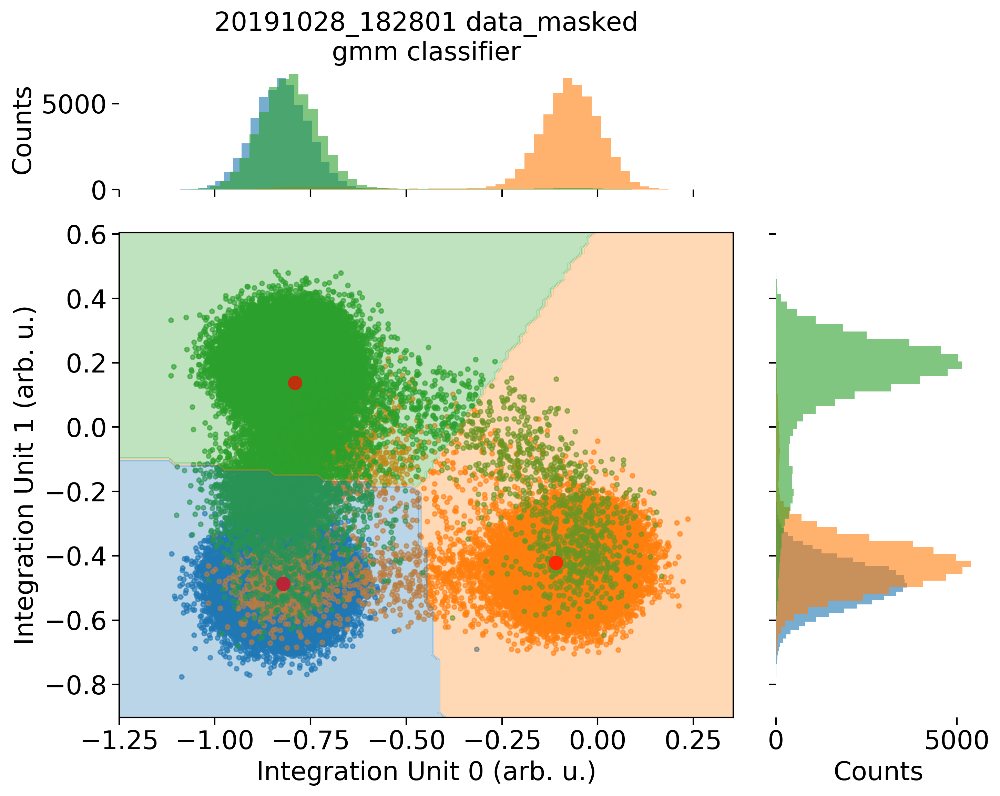

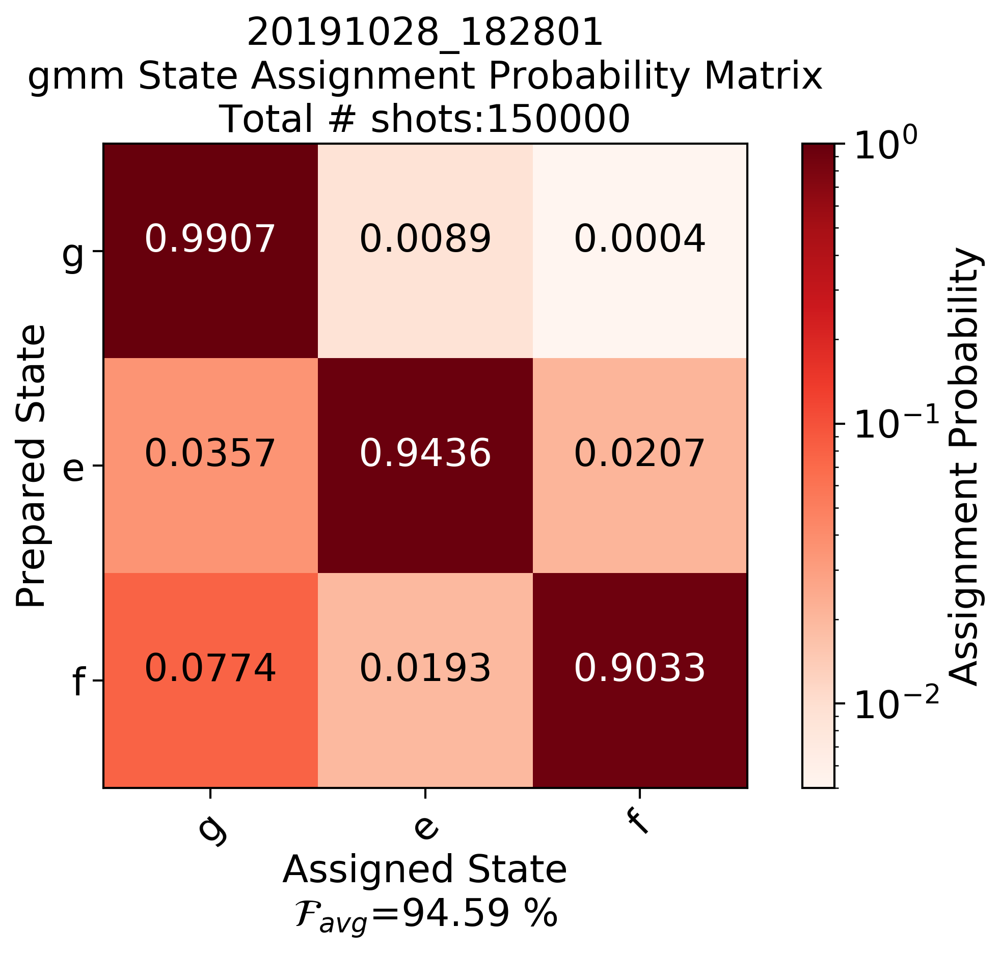

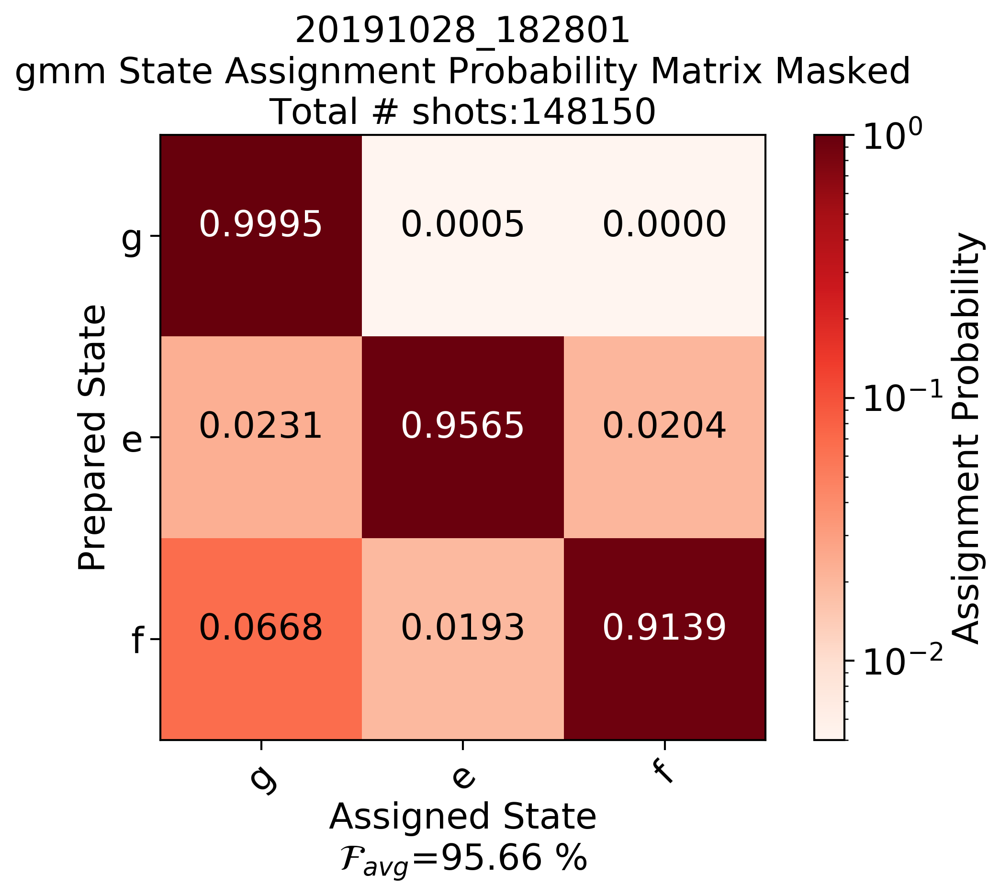

In [252]:

t_start = "20191028_181312"
t_end = "20191028_182945"
qbn = "qb1"
amplitudes = []
tps = a_tools.get_timestamps_in_range(t_start, t_end)
levels = ['g', 'e', 'f']
avg_f = []
h5mode =  'r+'
fms = []
for i in range(int(len(tps)/3)):
    options = dict(pre_selection=True, classif_method='gmm', show=False, classif_kw=dict(), 
               hist_scale="linear")
    a = ra.Singleshot_Readout_Analysis_Qutrit(t_start =tps[i*3:i*3+3], auto=Falselse,
                                               levels=levels,
                                               options_dict=options)
    a.extract_data()
    a.process_data()
    avg_f.append(np.mean(a.proc_data_dict['analysis_params']['state_prob_mtx_masked'][np.eye(3, dtype=bool)]))
    fms.append(a.proc_data_dict['analysis_params']['state_prob_mtx_masked'])
    folder = a_tools.get_folder(tps[i*3])
    h5filepath = a_tools.measurement_filename(folder)
    data_file = h5py.File(h5filepath, h5mode)
    amplitudes.append(eval(data_file['Instrument settings'][qbn].attrs["ro_amp"])*2)
    
amplitudes = np.array(amplitudes)
avg_f = np.array(avg_f)

# Comparison to Threshold

In [4]:
from scipy.stats import multivariate_normal
def wrap_predict(x, y, clf, target_class):
    mean = clf.means_[target_class]
    if clf.covariance_type == 'tied':
        cov = clf.covariances_
    elif clf.covariance_type == 'full':
        cov = clf.covariances_[target_class] 
    else:
        raise NotImplementedError()
    return multivariate_normal.pdf([[x, y]], mean=mean, cov=cov)

def wrap_sample(n_samples, clf, target_class):
    mean = clf.means_[target_class]
    if clf.covariance_type == 'tied':
        cov = clf.covariances_
    elif clf.covariance_type == 'full':
        cov = clf.covariances_[target_class] 
    else:
        raise NotImplementedError()
    
    return np.asarray([multivariate_normal.rvs( mean=mean, cov=cov) for _ in range(n_samples)])

[Text(334.8, 362.4, 'X[1] <= -0.108\nentropy = 0.667\nsamples = 150000\nvalue = [50000, 50000, 50000]'),
 Text(167.4, 217.44, 'X[0] <= -0.342\nentropy = 0.517\nsamples = 101603\nvalue = [49954, 49908, 1741]'),
 Text(83.7, 72.47999999999996, 'entropy = 0.09\nsamples = 51867\nvalue = [49437, 1358, 1072]'),
 Text(251.10000000000002, 72.47999999999996, 'entropy = 0.047\nsamples = 49736\nvalue = [517, 48550, 669]'),
 Text(502.20000000000005, 217.44, 'X[0] <= -0.149\nentropy = 0.006\nsamples = 48397\nvalue = [46, 92, 48259]'),
 Text(418.5, 72.47999999999996, 'entropy = 0.003\nsamples = 48234\nvalue = [44, 37, 48153]'),
 Text(585.9, 72.47999999999996, 'entropy = 0.463\nsamples = 163\nvalue = [2, 55, 106]')]

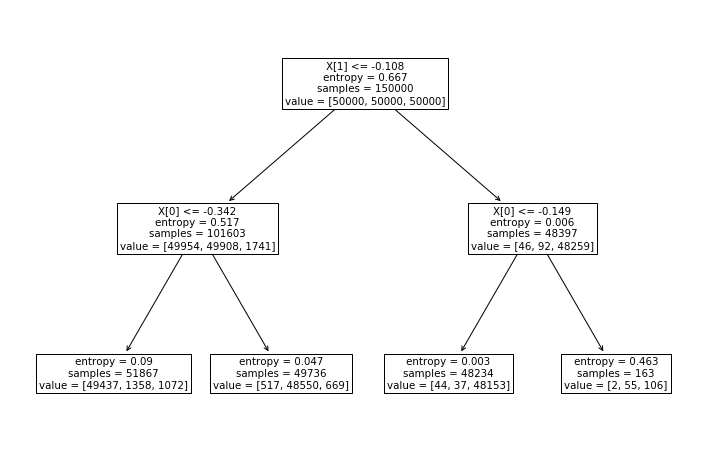

In [5]:
from sklearn.tree.export import export_text, plot_tree
fig, ax = plt.subplots(figsize=(12,8))
plot_tree(athr.clf_, ax=ax)

In [12]:
from collections import OrderedDict
import itertools
def _extract_tree_info(tree_clf, class_names=None):
    tree_ = tree_clf.tree_
    feature_name = [np.arange(tree_.n_features)[i]
                    for i in tree_.feature]
    print(feature_name)
    if class_names is None:
        class_names = np.arange(len(tree_.value[0]))
    thresholds, mapping = OrderedDict(), dict()

    def recurse(node, thresholds_final, loc, mapping, feature_depth_path):
        name = feature_name[node]
        feature_depth_path = feature_depth_path.copy() + [tree_.feature[node]]
        
        if tree_.feature[node] != -2:
            threshold = tree_.threshold[node]
            if not name in thresholds_final.keys():
                thresholds_final[name] = threshold
            recurse(tree_.children_left[node], thresholds_final,
                    loc + [0], mapping, feature_depth_path)
            recurse(tree_.children_right[node], thresholds_final,
                    loc + [1], mapping, feature_depth_path)
        else:
            print(loc, tree_.value[node], feature_depth_path)
            if len(loc) < tree_.n_features:
                print("Location < n_features, threshold mapping might not be correct")
                for l in itertools.combinations_with_replacement([0,1], tree_.n_features - len(loc)):
                    
                    loc_full =  loc + list(l)
                    #print(loc_full)
                    mapping[tuple([loc_full[i] for i in np.argsort(feature_depth_path[:-1])])] = class_names[np.argmax(tree_.value[node])]
                    #print(mapping)
            else:
                # swap if first threshold is on axis 1 FIXME: will work only when 2 integration units are used
                if list(thresholds_final.keys())[0] == 1:
                    loc = list(reversed(loc))
                mapping[tuple(loc)] = class_names[np.argmax(tree_.value[node])]
                print(mapping)
    recurse(0, thresholds, [], mapping,feature_depth_path=[])

    #translate keys to codeword index format
    mapping = {ra.Singleshot_Readout_Analysis_Qutrit._to_codeword_idx(k): v
               for k, v in mapping.items()}
    if len(mapping) < 2**tree_clf.max_depth:
        print(f"threshold mapping is of length {len(mapping)} instead of expected length {2**tree_clf.max_depth}. Mapping may be incorrect.")
    return thresholds, mapping

In [13]:
def threshold_infidelity(clf, target_class, clf_params, sigma=None, mean=None, class_mapping=dict(g=0, e=1, f=2)):
    mapping = clf_params['mapping']
    keys = [k for k in mapping if mapping[k] == target_class]
    if mean is None:
        mean = clf.means_[class_mapping[target_class]]
    if sigma is not None:
        cov = np.eye(2) * sigma **2
    elif clf.covariance_type == 'tied':
        cov = clf.covariances_
    elif clf.covariance_type == 'full':
        cov = clf.covariances_[target_class] 
    else:
        raise NotImplementedError()
    # p[i] is the prob of finding a datapoint in the quadrant i with:
    #  2 | 3
    # ------
    #  0 | 1
    # on that axis else 1
    p = dict()
    p[0] = multivariate_normal.cdf([clf_params['thresholds'][0], clf_params['thresholds'][1]], 
                                   mean=mean, cov=cov)
    p['(0, 0) (1, 0)'] = multivariate_normal.cdf([clf_params['thresholds'][0],  np.inf], 
                                                 mean=mean, cov=cov)
    p['(0, 0) (0, 1)'] = multivariate_normal.cdf([np.inf,  clf_params['thresholds'][1]], 
                                                 mean=mean, cov=cov)
    p[1] = p['(0, 0) (0, 1)'] - p[0]
    p[2] = p['(0, 0) (1, 0)'] - p[0]
    p[3] = 1 -  p[0] - p[1] -  p[2]
#     print(p)
#     print(keys)
    sum_quadrants = np.sum([p[k] for k in keys])
    return 1 - sum_quadrants
        
#max_fid_thr = [1-threshold_infidelity(agmm.clf_, i, athr.proc_data_dict["analysis_params"]["classifier_params"]) for i in 'gef']